# Afriat

In [1]:
scan=0.125

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: yvx8vxvl
Name: splendid-blaze-137
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/yvx8vxvl
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_121716-yvx8vxvl/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2575,3274,9394
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2575,2539,1683,3440,1644,3362
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4479,10764
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 630,835,2345
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 630,663,425,850,405,837
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1105,2705
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:18<3:02:27, 18.28s/it]

Epoch 1/600:   0%|▎                                                                                                                                                        | 1/600 [00:18<3:02:27, 18.28s/it, v_num=vl_1, total_loss_train=3.74e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▎                                                                                                                                                        | 1/600 [00:18<3:02:27, 18.28s/it, v_num=vl_1, total_loss_train=3.74e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:32<2:35:28, 15.60s/it, v_num=vl_1, total_loss_train=3.74e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:32<2:35:28, 15.60s/it, v_num=vl_1, total_loss_train=3.23e+3, kl_local_train=56.3]

Epoch 3/600:   0%|▌                                                                                                                                                        | 2/600 [00:32<2:35:28, 15.60s/it, v_num=vl_1, total_loss_train=3.23e+3, kl_local_train=56.3]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:46<2:28:00, 14.88s/it, v_num=vl_1, total_loss_train=3.23e+3, kl_local_train=56.3]

Epoch 3/600:   0%|▊                                                                                                                                                          | 3/600 [00:46<2:28:00, 14.88s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 4/600:   0%|▊                                                                                                                                                          | 3/600 [00:46<2:28:00, 14.88s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:59<2:23:32, 14.45s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=55]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:59<2:23:32, 14.45s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=50.5]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:59<2:23:32, 14.45s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=50.5]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:14<2:22:45, 14.40s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=50.5]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:14<2:22:45, 14.40s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=42.6]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [01:15<2:22:45, 14.40s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=42.6]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [01:29<2:24:24, 14.59s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=42.6]

Epoch 6/600:   1%|▎                        | 6/600 [01:29<2:24:24, 14.59s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=30.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▎                        | 6/600 [01:29<2:24:24, 14.59s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=30.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▎                        | 7/600 [01:42<2:21:13, 14.29s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=30.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▎                         | 7/600 [01:42<2:21:13, 14.29s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=30, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▎                         | 7/600 [01:42<2:21:13, 14.29s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=30, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▎                         | 8/600 [01:56<2:19:03, 14.09s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=30, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▎                       | 8/600 [01:56<2:19:03, 14.09s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 9/600:   1%|▎                       | 8/600 [01:56<2:19:03, 14.09s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 9/600:   2%|▎                       | 9/600 [02:09<2:16:43, 13.88s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=31.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 9/600:   2%|▎                       | 9/600 [02:09<2:16:43, 13.88s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=34.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                      | 9/600 [02:09<2:16:43, 13.88s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=34.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                     | 10/600 [02:23<2:17:01, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=34.3, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                     | 10/600 [02:23<2:17:01, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=37.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▎                     | 10/600 [02:25<2:17:01, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=37.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▍                     | 11/600 [02:38<2:19:43, 14.23s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=37.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.011, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▍                    | 11/600 [02:38<2:19:43, 14.23s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=42.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 12/600:   2%|▍                    | 11/600 [02:38<2:19:43, 14.23s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=42.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 12/600:   2%|▍                    | 12/600 [02:52<2:17:16, 14.01s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=42.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 12/600:   2%|▍                    | 12/600 [02:52<2:17:16, 14.01s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=46.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 13/600:   2%|▍                    | 12/600 [02:52<2:17:16, 14.01s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=46.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 13/600:   2%|▍                    | 13/600 [03:05<2:15:06, 13.81s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=46.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 13/600:   2%|▍                    | 13/600 [03:05<2:15:06, 13.81s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=50.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 14/600:   2%|▍                    | 13/600 [03:05<2:15:06, 13.81s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=50.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 14/600:   2%|▍                    | 14/600 [03:19<2:14:06, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=50.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 14/600:   2%|▍                    | 14/600 [03:19<2:14:06, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=55.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 15/600:   2%|▍                    | 14/600 [03:19<2:14:06, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=55.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 15/600:   2%|▌                    | 15/600 [03:32<2:14:03, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=55.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 15/600:   2%|▌                    | 15/600 [03:32<2:14:03, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=62.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 16/600:   2%|▌                    | 15/600 [03:34<2:14:03, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=62.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 16/600:   3%|▌                    | 16/600 [03:47<2:17:28, 14.12s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=62.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0733]

Epoch 16/600:   3%|▌                    | 16/600 [03:47<2:17:28, 14.12s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 17/600:   3%|▌                    | 16/600 [03:47<2:17:28, 14.12s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 17/600:   3%|▌                    | 17/600 [04:01<2:15:42, 13.97s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 17/600:   3%|▌                    | 17/600 [04:01<2:15:42, 13.97s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 18/600:   3%|▌                    | 17/600 [04:01<2:15:42, 13.97s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 18/600:   3%|▋                    | 18/600 [04:15<2:14:13, 13.84s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 18/600:   3%|▋                    | 18/600 [04:15<2:14:13, 13.84s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 19/600:   3%|▋                    | 18/600 [04:15<2:14:13, 13.84s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 19/600:   3%|▋                    | 19/600 [04:28<2:13:08, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 19/600:   3%|▋                    | 19/600 [04:28<2:13:08, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 20/600:   3%|▋                    | 19/600 [04:28<2:13:08, 13.75s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 20/600:   3%|▋                    | 20/600 [04:42<2:13:10, 13.78s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 20/600:   3%|▋                    | 20/600 [04:42<2:13:10, 13.78s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 21/600:   3%|▋                    | 20/600 [04:43<2:13:10, 13.78s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 21/600:   4%|▋                    | 21/600 [04:57<2:15:41, 14.06s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0873]

Epoch 21/600:   4%|▊                     | 21/600 [04:57<2:15:41, 14.06s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=96.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                     | 21/600 [04:57<2:15:41, 14.06s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=96.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                     | 22/600 [05:10<2:13:12, 13.83s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=96.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 22/600:   4%|▊                      | 22/600 [05:10<2:13:12, 13.83s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▊                      | 22/600 [05:10<2:13:12, 13.83s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▉                      | 23/600 [05:23<2:11:19, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 23/600:   4%|▉                      | 23/600 [05:23<2:11:19, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▉                      | 23/600 [05:23<2:11:19, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▉                      | 24/600 [05:37<2:09:59, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=105, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 24/600:   4%|▉                      | 24/600 [05:37<2:09:59, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                      | 24/600 [05:37<2:09:59, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                      | 25/600 [05:50<2:09:48, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 25/600:   4%|▉                      | 25/600 [05:50<2:09:48, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|▉                      | 25/600 [05:51<2:09:48, 13.54s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|▉                      | 26/600 [06:05<2:12:49, 13.88s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.112]

Epoch 26/600:   4%|█                       | 26/600 [06:05<2:12:49, 13.88s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 27/600:   4%|█                       | 26/600 [06:05<2:12:49, 13.88s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 27/600:   4%|█                       | 27/600 [06:18<2:10:53, 13.71s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 27/600:   4%|█                       | 27/600 [06:18<2:10:53, 13.71s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 28/600:   4%|█                       | 27/600 [06:18<2:10:53, 13.71s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 28/600:   5%|█                       | 28/600 [06:31<2:09:31, 13.59s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 28/600:   5%|█                       | 28/600 [06:31<2:09:31, 13.59s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 29/600:   5%|█                       | 28/600 [06:31<2:09:31, 13.59s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 29/600:   5%|█▏                      | 29/600 [06:45<2:08:40, 13.52s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 29/600:   5%|█▏                      | 29/600 [06:45<2:08:40, 13.52s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 30/600:   5%|█▏                      | 29/600 [06:45<2:08:40, 13.52s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 30/600:   5%|█▏                      | 30/600 [06:58<2:08:45, 13.55s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 30/600:   5%|█▏                      | 30/600 [06:58<2:08:45, 13.55s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 31/600:   5%|█▏                      | 30/600 [07:00<2:08:45, 13.55s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 31/600:   5%|█▏                      | 31/600 [07:13<2:12:10, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0693, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.118]

Epoch 31/600:   5%|█▏                      | 31/600 [07:13<2:12:10, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 32/600:   5%|█▏                      | 31/600 [07:13<2:12:10, 13.94s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 32/600:   5%|█▎                      | 32/600 [07:26<2:09:58, 13.73s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 32/600:   5%|█▎                      | 32/600 [07:26<2:09:58, 13.73s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 33/600:   5%|█▎                      | 32/600 [07:26<2:09:58, 13.73s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 33/600:   6%|█▎                      | 33/600 [07:40<2:08:53, 13.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 33/600:   6%|█▎                      | 33/600 [07:40<2:08:53, 13.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 34/600:   6%|█▎                      | 33/600 [07:40<2:08:53, 13.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 34/600:   6%|█▎                      | 34/600 [07:53<2:07:35, 13.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 34/600:   6%|█▎                      | 34/600 [07:53<2:07:35, 13.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 35/600:   6%|█▎                      | 34/600 [07:53<2:07:35, 13.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 35/600:   6%|█▍                      | 35/600 [08:09<2:14:40, 14.30s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 35/600:   6%|█▍                      | 35/600 [08:09<2:14:40, 14.30s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 36/600:   6%|█▍                      | 35/600 [08:11<2:14:40, 14.30s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 36/600:   6%|█▍                      | 36/600 [08:27<2:23:53, 15.31s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.122]

Epoch 36/600:   6%|█▌                       | 36/600 [08:27<2:23:53, 15.31s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 37/600:   6%|█▌                       | 36/600 [08:27<2:23:53, 15.31s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 37/600:   6%|█▌                       | 37/600 [08:43<2:24:55, 15.45s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 37/600:   6%|█▌                       | 37/600 [08:43<2:24:55, 15.45s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 38/600:   6%|█▌                       | 37/600 [08:43<2:24:55, 15.45s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 38/600:   6%|█▌                       | 38/600 [08:58<2:24:36, 15.44s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=119, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 38/600:   6%|█▌                       | 38/600 [08:58<2:24:36, 15.44s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 39/600:   6%|█▌                       | 38/600 [08:58<2:24:36, 15.44s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 39/600:   6%|█▋                       | 39/600 [09:14<2:26:12, 15.64s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 39/600:   6%|█▋                       | 39/600 [09:14<2:26:12, 15.64s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 40/600:   6%|█▋                       | 39/600 [09:14<2:26:12, 15.64s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 40/600:   7%|█▋                       | 40/600 [09:31<2:29:04, 15.97s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 40/600:   7%|█▋                       | 40/600 [09:31<2:29:04, 15.97s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 41/600:   7%|█▋                       | 40/600 [09:32<2:29:04, 15.97s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 41/600:   7%|█▋                       | 41/600 [09:49<2:35:05, 16.65s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=118, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.124]

Epoch 41/600:   7%|█▊                         | 41/600 [09:49<2:35:05, 16.65s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 42/600:   7%|█▊                         | 41/600 [09:49<2:35:05, 16.65s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 42/600:   7%|█▉                         | 42/600 [10:07<2:37:02, 16.89s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 42/600:   7%|█▉                         | 42/600 [10:07<2:37:02, 16.89s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 43/600:   7%|█▉                         | 42/600 [10:07<2:37:02, 16.89s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 43/600:   7%|█▉                         | 43/600 [10:24<2:37:47, 17.00s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 43/600:   7%|█▉                         | 43/600 [10:24<2:37:47, 17.00s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 44/600:   7%|█▉                         | 43/600 [10:24<2:37:47, 17.00s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 44/600:   7%|█▉                         | 44/600 [10:41<2:37:01, 16.94s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 44/600:   7%|█▉                         | 44/600 [10:41<2:37:01, 16.94s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 45/600:   7%|█▉                         | 44/600 [10:41<2:37:01, 16.94s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 45/600:   8%|██                         | 45/600 [10:57<2:36:00, 16.87s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 45/600:   8%|██                         | 45/600 [10:57<2:36:00, 16.87s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 46/600:   8%|██                         | 45/600 [10:59<2:36:00, 16.87s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 46/600:   8%|██                         | 46/600 [11:12<2:29:58, 16.24s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=117, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.125]

Epoch 46/600:   8%|█▉                        | 46/600 [11:12<2:29:58, 16.24s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                        | 46/600 [11:12<2:29:58, 16.24s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                        | 47/600 [11:26<2:21:41, 15.37s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                        | 47/600 [11:26<2:21:41, 15.37s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 47/600 [11:26<2:21:41, 15.37s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 48/600 [11:39<2:15:40, 14.75s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 48/600 [11:39<2:15:40, 14.75s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 48/600 [11:39<2:15:40, 14.75s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 49/600 [11:52<2:11:21, 14.30s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 49/600 [11:52<2:11:21, 14.30s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                        | 49/600 [11:52<2:11:21, 14.30s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▏                       | 50/600 [12:08<2:14:58, 14.72s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=116, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▏                       | 50/600 [12:08<2:14:58, 14.72s/it, v_num=vl_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 50/600 [12:09<2:14:58, 14.72s/it, v_num=vl_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 51/600 [12:25<2:21:43, 15.49s/it, v_num=vl_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 51/600 [12:25<2:21:43, 15.49s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 52/600:   8%|██▏                       | 51/600 [12:25<2:21:43, 15.49s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|██▎                       | 52/600 [12:41<2:21:52, 15.53s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|██▎                       | 52/600 [12:41<2:21:52, 15.53s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▎                       | 52/600 [12:41<2:21:52, 15.53s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▎                       | 53/600 [12:57<2:22:31, 15.63s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|██▎                       | 53/600 [12:57<2:22:31, 15.63s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▎                       | 53/600 [12:57<2:22:31, 15.63s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▎                       | 54/600 [13:13<2:24:21, 15.86s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|██▎                       | 54/600 [13:13<2:24:21, 15.86s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▎                       | 54/600 [13:13<2:24:21, 15.86s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▍                       | 55/600 [13:29<2:25:14, 15.99s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|██▍                       | 55/600 [13:29<2:25:14, 15.99s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▍                       | 55/600 [13:31<2:25:14, 15.99s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▍                       | 56/600 [13:47<2:29:37, 16.50s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|██▎                      | 56/600 [13:47<2:29:37, 16.50s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 57/600:   9%|██▎                      | 56/600 [13:47<2:29:37, 16.50s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                      | 57/600 [14:03<2:27:13, 16.27s/it, v_num=vl_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                       | 57/600 [14:03<2:27:13, 16.27s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                       | 57/600 [14:03<2:27:13, 16.27s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [14:18<2:25:43, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [14:18<2:25:43, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 58/600 [14:18<2:25:43, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [14:34<2:25:00, 16.08s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [14:34<2:25:00, 16.08s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 59/600 [14:34<2:25:00, 16.08s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [14:51<2:25:07, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [14:51<2:25:07, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                       | 60/600 [14:52<2:25:07, 16.13s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [15:08<2:27:46, 16.45s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [15:08<2:27:46, 16.45s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▋                       | 61/600 [15:08<2:27:46, 16.45s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▋                       | 62/600 [15:24<2:26:20, 16.32s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▋                       | 62/600 [15:24<2:26:20, 16.32s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                       | 62/600 [15:24<2:26:20, 16.32s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                       | 63/600 [15:40<2:24:38, 16.16s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                       | 63/600 [15:40<2:24:38, 16.16s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  10%|██▋                       | 63/600 [15:40<2:24:38, 16.16s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▊                       | 64/600 [15:55<2:23:05, 16.02s/it, v_num=vl_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▌                     | 64/600 [15:55<2:23:05, 16.02s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 64/600 [15:55<2:23:05, 16.02s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 65/600 [16:11<2:22:31, 15.98s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 65/600 [16:11<2:22:31, 15.98s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▌                     | 65/600 [16:13<2:22:31, 15.98s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [16:28<2:25:27, 16.34s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=98.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [16:28<2:25:27, 16.34s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▋                     | 66/600 [16:28<2:25:27, 16.34s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▋                     | 67/600 [16:45<2:25:03, 16.33s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▋                     | 67/600 [16:45<2:25:03, 16.33s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▋                     | 67/600 [16:45<2:25:03, 16.33s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▋                     | 68/600 [17:01<2:23:55, 16.23s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▋                     | 68/600 [17:01<2:23:55, 16.23s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  11%|██▋                     | 68/600 [17:01<2:23:55, 16.23s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|██▊                     | 69/600 [17:17<2:23:12, 16.18s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|██▊                     | 69/600 [17:17<2:23:12, 16.18s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|██▊                     | 69/600 [17:17<2:23:12, 16.18s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|██▊                     | 70/600 [17:33<2:22:48, 16.17s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|██▊                     | 70/600 [17:33<2:22:48, 16.17s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=93.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|██▊                     | 70/600 [17:35<2:22:48, 16.17s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=93.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|██▊                     | 71/600 [17:51<2:26:24, 16.61s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=93.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|██▊                     | 71/600 [17:51<2:26:24, 16.61s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=92.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▊                     | 71/600 [17:51<2:26:24, 16.61s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=92.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▉                     | 72/600 [18:06<2:23:55, 16.36s/it, v_num=vl_1, total_loss_train=3.19e+3, kl_local_train=92.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|██▉                     | 72/600 [18:06<2:23:55, 16.36s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|██▉                     | 72/600 [18:06<2:23:55, 16.36s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|██▉                     | 73/600 [18:22<2:21:34, 16.12s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|███▏                      | 73/600 [18:22<2:21:34, 16.12s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|███▏                      | 73/600 [18:22<2:21:34, 16.12s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|███▏                      | 74/600 [18:38<2:20:06, 15.98s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=91, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|██▉                     | 74/600 [18:38<2:20:06, 15.98s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=90.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|██▉                     | 74/600 [18:38<2:20:06, 15.98s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=90.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|███                     | 75/600 [18:53<2:18:19, 15.81s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=90.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|███                     | 75/600 [18:53<2:18:19, 15.81s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  12%|███                     | 75/600 [18:55<2:18:19, 15.81s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|███                     | 76/600 [19:11<2:24:22, 16.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|███▏                     | 76/600 [19:11<2:24:22, 16.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▏                     | 76/600 [19:11<2:24:22, 16.53s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▏                     | 77/600 [19:28<2:25:02, 16.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▍                       | 77/600 [19:28<2:25:02, 16.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▍                       | 77/600 [19:28<2:25:02, 16.64s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▌                       | 78/600 [19:43<2:21:19, 16.24s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▎                     | 78/600 [19:43<2:21:19, 16.24s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▎                     | 78/600 [19:43<2:21:19, 16.24s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▎                     | 79/600 [20:00<2:22:00, 16.35s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▎                     | 79/600 [20:00<2:22:00, 16.35s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▎                     | 79/600 [20:00<2:22:00, 16.35s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▎                     | 80/600 [20:14<2:16:30, 15.75s/it, v_num=vl_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▎                     | 80/600 [20:14<2:16:30, 15.75s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  13%|███▎                     | 80/600 [20:16<2:16:30, 15.75s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  14%|███▍                     | 81/600 [20:30<2:16:17, 15.76s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  14%|███▏                    | 81/600 [20:30<2:16:17, 15.76s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 82/600:  14%|███▏                    | 81/600 [20:30<2:16:17, 15.76s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 82/600:  14%|███▎                    | 82/600 [20:44<2:12:23, 15.34s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 82/600:  14%|███▎                    | 82/600 [20:44<2:12:23, 15.34s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|███▎                    | 82/600 [20:44<2:12:23, 15.34s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|███▎                    | 83/600 [20:58<2:08:27, 14.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|███▎                    | 83/600 [20:58<2:08:27, 14.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|███▎                    | 83/600 [20:58<2:08:27, 14.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|███▎                    | 84/600 [21:12<2:04:19, 14.46s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=84.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|███▎                    | 84/600 [21:12<2:04:19, 14.46s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|███▎                    | 84/600 [21:12<2:04:19, 14.46s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|███▍                    | 85/600 [21:25<2:01:51, 14.20s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|███▍                    | 85/600 [21:25<2:01:51, 14.20s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|███▍                    | 85/600 [21:27<2:01:51, 14.20s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|███▍                    | 86/600 [21:40<2:03:23, 14.40s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|███▍                    | 86/600 [21:40<2:03:23, 14.40s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|███▍                    | 86/600 [21:40<2:03:23, 14.40s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|███▍                    | 87/600 [21:54<2:00:43, 14.12s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|███▍                    | 87/600 [21:54<2:00:43, 14.12s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 88/600:  14%|███▍                    | 87/600 [21:54<2:00:43, 14.12s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 88/600:  15%|███▌                    | 88/600 [22:07<1:58:40, 13.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 88/600:  15%|███▌                    | 88/600 [22:07<1:58:40, 13.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|███▌                    | 88/600 [22:07<1:58:40, 13.91s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|███▌                    | 89/600 [22:21<1:57:13, 13.76s/it, v_num=vl_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|███▌                    | 89/600 [22:21<1:57:13, 13.76s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|███▌                    | 89/600 [22:21<1:57:13, 13.76s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|███▌                    | 90/600 [22:34<1:56:22, 13.69s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|███▉                      | 90/600 [22:34<1:56:22, 13.69s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|███▉                      | 90/600 [22:35<1:56:22, 13.69s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|███▉                      | 91/600 [22:49<1:59:01, 14.03s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=81, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|███▊                     | 91/600 [22:49<1:59:01, 14.03s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 92/600:  15%|███▊                     | 91/600 [22:49<1:59:01, 14.03s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 92/600:  15%|███▊                     | 92/600 [23:02<1:57:10, 13.84s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 92/600:  15%|███▊                     | 92/600 [23:02<1:57:10, 13.84s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 93/600:  15%|███▊                     | 92/600 [23:02<1:57:10, 13.84s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 93/600:  16%|███▉                     | 93/600 [23:16<1:56:06, 13.74s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 93/600:  16%|███▉                     | 93/600 [23:16<1:56:06, 13.74s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|███▉                     | 93/600 [23:16<1:56:06, 13.74s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|███▉                     | 94/600 [23:29<1:54:57, 13.63s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|███▉                     | 94/600 [23:29<1:54:57, 13.63s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|███▉                     | 94/600 [23:29<1:54:57, 13.63s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|███▉                     | 95/600 [23:43<1:54:09, 13.56s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|███▉                     | 95/600 [23:43<1:54:09, 13.56s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|███▉                     | 95/600 [23:44<1:54:09, 13.56s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|████                     | 96/600 [23:57<1:56:52, 13.91s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|███▊                    | 96/600 [23:57<1:56:52, 13.91s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 97/600:  16%|███▊                    | 96/600 [23:57<1:56:52, 13.91s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 97/600:  16%|███▉                    | 97/600 [24:11<1:55:20, 13.76s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=78.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 97/600:  16%|███▉                    | 97/600 [24:11<1:55:20, 13.76s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|███▉                    | 97/600 [24:11<1:55:20, 13.76s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|███▉                    | 98/600 [24:24<1:54:18, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|███▉                    | 98/600 [24:24<1:54:18, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|███▉                    | 98/600 [24:24<1:54:18, 13.66s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|███▉                    | 99/600 [24:37<1:53:13, 13.56s/it, v_num=vl_1, total_loss_train=3.16e+3, kl_local_train=76.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|███▉                    | 99/600 [24:37<1:53:13, 13.56s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 100/600:  16%|███▊                   | 99/600 [24:37<1:53:13, 13.56s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 100/600:  17%|███▋                  | 100/600 [24:51<1:52:31, 13.50s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 100/600:  17%|███▋                  | 100/600 [24:51<1:52:31, 13.50s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|███▋                  | 100/600 [24:52<1:52:31, 13.50s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|███▋                  | 101/600 [25:06<1:55:24, 13.88s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|███▋                  | 101/600 [25:06<1:55:24, 13.88s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|███▋                  | 101/600 [25:06<1:55:24, 13.88s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|███▋                  | 102/600 [25:19<1:53:55, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|███▋                  | 102/600 [25:19<1:53:55, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|███▋                  | 102/600 [25:19<1:53:55, 13.73s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|███▊                  | 103/600 [25:33<1:54:01, 13.76s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|███▊                  | 103/600 [25:33<1:54:01, 13.76s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 104/600:  17%|███▊                  | 103/600 [25:33<1:54:01, 13.76s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 104/600:  17%|███▊                  | 104/600 [25:46<1:53:04, 13.68s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 104/600:  17%|███▊                  | 104/600 [25:46<1:53:04, 13.68s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 105/600:  17%|███▊                  | 104/600 [25:46<1:53:04, 13.68s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 105/600:  18%|███▊                  | 105/600 [26:00<1:52:49, 13.67s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 105/600:  18%|███▊                  | 105/600 [26:00<1:52:49, 13.67s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|███▊                  | 105/600 [26:01<1:52:49, 13.67s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|███▉                  | 106/600 [26:17<2:01:46, 14.79s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|███▉                  | 106/600 [26:17<2:01:46, 14.79s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|███▉                  | 106/600 [26:17<2:01:46, 14.79s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|███▉                  | 107/600 [26:34<2:05:14, 15.24s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|████▎                   | 107/600 [26:34<2:05:14, 15.24s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████▎                   | 107/600 [26:34<2:05:14, 15.24s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████▎                   | 108/600 [26:50<2:07:41, 15.57s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████▎                   | 108/600 [26:50<2:07:41, 15.57s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|████▎                   | 108/600 [26:50<2:07:41, 15.57s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|████▎                   | 109/600 [27:06<2:08:32, 15.71s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|███▉                  | 109/600 [27:06<2:08:32, 15.71s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|███▉                  | 109/600 [27:06<2:08:32, 15.71s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|████                  | 110/600 [27:22<2:09:03, 15.80s/it, v_num=vl_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|████                  | 110/600 [27:22<2:09:03, 15.80s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████                  | 110/600 [27:24<2:09:03, 15.80s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████                  | 111/600 [27:40<2:13:32, 16.39s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████                  | 111/600 [27:40<2:13:32, 16.39s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 112/600:  18%|████                  | 111/600 [27:40<2:13:32, 16.39s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████                  | 112/600 [27:56<2:11:35, 16.18s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████                  | 112/600 [27:56<2:11:35, 16.18s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████                  | 112/600 [27:56<2:11:35, 16.18s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▏                 | 113/600 [28:11<2:10:35, 16.09s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▏                 | 113/600 [28:11<2:10:35, 16.09s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▏                 | 113/600 [28:11<2:10:35, 16.09s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▏                 | 114/600 [28:27<2:08:15, 15.83s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▏                 | 114/600 [28:27<2:08:15, 15.83s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▏                 | 114/600 [28:27<2:08:15, 15.83s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▏                 | 115/600 [28:42<2:07:16, 15.75s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▏                 | 115/600 [28:42<2:07:16, 15.75s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▏                 | 115/600 [28:44<2:07:16, 15.75s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▎                 | 116/600 [28:59<2:10:02, 16.12s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▎                 | 116/600 [28:59<2:10:02, 16.12s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 117/600:  19%|████▎                 | 116/600 [28:59<2:10:02, 16.12s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|████▎                 | 117/600 [29:14<2:07:33, 15.85s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|████▎                 | 117/600 [29:14<2:07:33, 15.85s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 117/600 [29:14<2:07:33, 15.85s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 118/600 [29:30<2:05:45, 15.65s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 118/600 [29:30<2:05:45, 15.65s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 118/600 [29:30<2:05:45, 15.65s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 119/600 [29:45<2:04:21, 15.51s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 119/600 [29:45<2:04:21, 15.51s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▎                 | 119/600 [29:45<2:04:21, 15.51s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▍                 | 120/600 [30:00<2:04:12, 15.53s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▍                 | 120/600 [30:00<2:04:12, 15.53s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▍                 | 120/600 [30:02<2:04:12, 15.53s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▍                 | 121/600 [30:17<2:07:22, 15.96s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▋                  | 121/600 [30:17<2:07:22, 15.96s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 122/600:  20%|████▋                  | 121/600 [30:17<2:07:22, 15.96s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 122/600:  20%|████▋                  | 122/600 [30:33<2:06:38, 15.90s/it, v_num=vl_1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 122/600:  20%|████▋                  | 122/600 [30:33<2:06:38, 15.90s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 123/600:  20%|████▋                  | 122/600 [30:33<2:06:38, 15.90s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 123/600:  20%|████▋                  | 123/600 [30:48<2:04:35, 15.67s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 123/600:  20%|████▋                  | 123/600 [30:48<2:04:35, 15.67s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 124/600:  20%|████▋                  | 123/600 [30:48<2:04:35, 15.67s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 124/600:  21%|████▊                  | 124/600 [31:03<2:02:46, 15.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 124/600:  21%|████▊                  | 124/600 [31:03<2:02:46, 15.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 125/600:  21%|████▊                  | 124/600 [31:03<2:02:46, 15.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 125/600:  21%|████▊                  | 125/600 [31:19<2:02:18, 15.45s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 125/600:  21%|████▊                  | 125/600 [31:19<2:02:18, 15.45s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 126/600:  21%|████▊                  | 125/600 [31:20<2:02:18, 15.45s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 126/600:  21%|████▊                  | 126/600 [31:37<2:08:38, 16.28s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 126/600:  21%|████▊                  | 126/600 [31:37<2:08:38, 16.28s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|████▊                  | 126/600 [31:37<2:08:38, 16.28s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|████▊                  | 127/600 [31:54<2:09:20, 16.41s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|████▊                  | 127/600 [31:54<2:09:20, 16.41s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|████▊                  | 127/600 [31:54<2:09:20, 16.41s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|████▉                  | 128/600 [32:10<2:09:37, 16.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|████▉                  | 128/600 [32:10<2:09:37, 16.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 129/600:  21%|████▉                  | 128/600 [32:10<2:09:37, 16.48s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|████▉                  | 129/600 [32:25<2:06:35, 16.13s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|████▉                  | 129/600 [32:25<2:06:35, 16.13s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|████▉                  | 129/600 [32:25<2:06:35, 16.13s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|████▉                  | 130/600 [32:41<2:04:02, 15.84s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|████▉                  | 130/600 [32:41<2:04:02, 15.84s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|████▉                  | 130/600 [32:42<2:04:02, 15.84s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|█████                  | 131/600 [32:57<2:05:48, 16.10s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|████▊                 | 131/600 [32:57<2:05:48, 16.10s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 132/600:  22%|████▊                 | 131/600 [32:57<2:05:48, 16.10s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 132/600:  22%|████▊                 | 132/600 [33:12<2:02:52, 15.75s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 132/600:  22%|████▊                 | 132/600 [33:12<2:02:52, 15.75s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 133/600:  22%|████▊                 | 132/600 [33:12<2:02:52, 15.75s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 133/600:  22%|████▉                 | 133/600 [33:27<2:01:00, 15.55s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 133/600:  22%|████▉                 | 133/600 [33:27<2:01:00, 15.55s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 134/600:  22%|████▉                 | 133/600 [33:27<2:01:00, 15.55s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 134/600:  22%|████▉                 | 134/600 [33:42<1:59:23, 15.37s/it, v_num=vl_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 134/600:  22%|████▉                 | 134/600 [33:42<1:59:23, 15.37s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 135/600:  22%|████▉                 | 134/600 [33:42<1:59:23, 15.37s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 135/600:  22%|████▉                 | 135/600 [33:59<2:01:41, 15.70s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 135/600:  22%|████▉                 | 135/600 [33:59<2:01:41, 15.70s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 136/600:  22%|████▉                 | 135/600 [34:00<2:01:41, 15.70s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 136/600:  23%|████▉                 | 136/600 [34:19<2:10:53, 16.92s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 136/600:  23%|████▉                 | 136/600 [34:19<2:10:53, 16.92s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|████▉                 | 136/600 [34:19<2:10:53, 16.92s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████                 | 137/600 [34:35<2:08:55, 16.71s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████                 | 137/600 [34:35<2:08:55, 16.71s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 137/600 [34:35<2:08:55, 16.71s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 138/600 [34:51<2:06:32, 16.43s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████                 | 138/600 [34:51<2:06:32, 16.43s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 138/600 [34:51<2:06:32, 16.43s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 139/600 [35:06<2:04:46, 16.24s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████                 | 139/600 [35:06<2:04:46, 16.24s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████                 | 139/600 [35:06<2:04:46, 16.24s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▏                | 140/600 [35:22<2:03:30, 16.11s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▏                | 140/600 [35:22<2:03:30, 16.11s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 141/600:  23%|█████▏                | 140/600 [35:24<2:03:30, 16.11s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▏                | 141/600 [35:39<2:05:20, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▏                | 141/600 [35:39<2:05:20, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 141/600 [35:39<2:05:20, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 142/600 [35:55<2:02:43, 16.08s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|█████▏                | 142/600 [35:55<2:02:43, 16.08s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 142/600 [35:55<2:02:43, 16.08s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 143/600 [36:10<2:00:12, 15.78s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|█████▏                | 143/600 [36:10<2:00:12, 15.78s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▏                | 143/600 [36:10<2:00:12, 15.78s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▎                | 144/600 [36:25<1:58:07, 15.54s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|█████▎                | 144/600 [36:25<1:58:07, 15.54s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 144/600 [36:25<1:58:07, 15.54s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 145/600 [36:40<1:57:32, 15.50s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|█████▎                | 145/600 [36:40<1:57:32, 15.50s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████▎                | 145/600 [36:42<1:57:32, 15.50s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████▎                | 146/600 [36:58<2:03:16, 16.29s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|█████▊                  | 146/600 [36:58<2:03:16, 16.29s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|█████▊                  | 146/600 [36:58<2:03:16, 16.29s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|█████▉                  | 147/600 [37:15<2:03:40, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|█████▍                | 147/600 [37:15<2:03:40, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 148/600:  24%|█████▍                | 147/600 [37:15<2:03:40, 16.38s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|█████▍                | 148/600 [37:31<2:02:20, 16.24s/it, v_num=vl_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|█████▍                | 148/600 [37:31<2:02:20, 16.24s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|█████▍                | 148/600 [37:31<2:02:20, 16.24s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|█████▍                | 149/600 [37:46<2:00:31, 16.03s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|█████▍                | 149/600 [37:46<2:00:31, 16.03s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|█████▍                | 149/600 [37:46<2:00:31, 16.03s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|█████▌                | 150/600 [38:02<2:00:21, 16.05s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|█████▌                | 150/600 [38:02<2:00:21, 16.05s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|█████▌                | 150/600 [38:04<2:00:21, 16.05s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|█████▌                | 151/600 [38:19<2:01:56, 16.30s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|█████▌                | 151/600 [38:19<2:01:56, 16.30s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 152/600:  25%|█████▌                | 151/600 [38:19<2:01:56, 16.30s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 152/600:  25%|█████▌                | 152/600 [38:32<1:55:00, 15.40s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 152/600:  25%|█████▌                | 152/600 [38:32<1:55:00, 15.40s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 153/600:  25%|█████▌                | 152/600 [38:32<1:55:00, 15.40s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 153/600:  26%|█████▌                | 153/600 [38:46<1:50:14, 14.80s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 153/600:  26%|█████▌                | 153/600 [38:46<1:50:14, 14.80s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 154/600:  26%|█████▌                | 153/600 [38:46<1:50:14, 14.80s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 154/600:  26%|█████▋                | 154/600 [38:59<1:46:43, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 154/600:  26%|██████▏                 | 154/600 [38:59<1:46:43, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 155/600:  26%|██████▏                 | 154/600 [38:59<1:46:43, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 155/600:  26%|██████▏                 | 155/600 [39:13<1:44:58, 14.15s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 155/600:  26%|██████▏                 | 155/600 [39:13<1:44:58, 14.15s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 156/600:  26%|██████▏                 | 155/600 [39:14<1:44:58, 14.15s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 156/600:  26%|██████▏                 | 156/600 [39:28<1:46:15, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 156/600:  26%|██████▏                 | 156/600 [39:28<1:46:15, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██████▏                 | 156/600 [39:28<1:46:15, 14.36s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██████▎                 | 157/600 [39:41<1:44:06, 14.10s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|█████▊                | 157/600 [39:41<1:44:06, 14.10s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|█████▊                | 157/600 [39:41<1:44:06, 14.10s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|█████▊                | 158/600 [39:55<1:42:16, 13.88s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|█████▊                | 158/600 [39:55<1:42:16, 13.88s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|█████▊                | 158/600 [39:55<1:42:16, 13.88s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|█████▊                | 159/600 [40:08<1:41:15, 13.78s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|█████▊                | 159/600 [40:08<1:41:15, 13.78s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 160/600:  26%|█████▊                | 159/600 [40:08<1:41:15, 13.78s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|█████▊                | 160/600 [40:22<1:40:35, 13.72s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|█████▊                | 160/600 [40:22<1:40:35, 13.72s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|█████▊                | 160/600 [40:23<1:40:35, 13.72s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|█████▉                | 161/600 [40:36<1:42:35, 14.02s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|█████▋               | 161/600 [40:36<1:42:35, 14.02s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 162/600:  27%|█████▋               | 161/600 [40:36<1:42:35, 14.02s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 162/600:  27%|█████▋               | 162/600 [40:50<1:40:47, 13.81s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 162/600:  27%|██████▏                | 162/600 [40:50<1:40:47, 13.81s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 163/600:  27%|██████▏                | 162/600 [40:50<1:40:47, 13.81s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 163/600:  27%|██████▏                | 163/600 [41:03<1:39:27, 13.66s/it, v_num=vl_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 163/600:  27%|█████▉                | 163/600 [41:03<1:39:27, 13.66s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 164/600:  27%|█████▉                | 163/600 [41:03<1:39:27, 13.66s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 164/600:  27%|██████                | 164/600 [41:16<1:38:38, 13.58s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 164/600:  27%|██████                | 164/600 [41:16<1:38:38, 13.58s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 165/600:  27%|██████                | 164/600 [41:16<1:38:38, 13.58s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 165/600:  28%|██████                | 165/600 [41:30<1:38:15, 13.55s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 165/600:  28%|██████                | 165/600 [41:30<1:38:15, 13.55s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 166/600:  28%|██████                | 165/600 [41:31<1:38:15, 13.55s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 166/600:  28%|██████                | 166/600 [41:44<1:40:15, 13.86s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 166/600:  28%|██████                | 166/600 [41:44<1:40:15, 13.86s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 167/600:  28%|██████                | 166/600 [41:45<1:40:15, 13.86s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 167/600:  28%|██████                | 167/600 [41:58<1:38:44, 13.68s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 167/600:  28%|██████                | 167/600 [41:58<1:38:44, 13.68s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 168/600:  28%|██████                | 167/600 [41:58<1:38:44, 13.68s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 168/600:  28%|██████▏               | 168/600 [42:11<1:38:15, 13.65s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 168/600:  28%|██████▋                 | 168/600 [42:11<1:38:15, 13.65s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 169/600:  28%|██████▋                 | 168/600 [42:11<1:38:15, 13.65s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 169/600:  28%|██████▊                 | 169/600 [42:25<1:37:15, 13.54s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 169/600:  28%|██████▏               | 169/600 [42:25<1:37:15, 13.54s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 170/600:  28%|██████▏               | 169/600 [42:25<1:37:15, 13.54s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 170/600:  28%|██████▏               | 170/600 [42:38<1:36:59, 13.53s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 170/600:  28%|██████▏               | 170/600 [42:38<1:36:59, 13.53s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 171/600:  28%|██████▏               | 170/600 [42:40<1:36:59, 13.53s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 171/600:  28%|██████▎               | 171/600 [42:53<1:39:25, 13.91s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.102]

Epoch 171/600:  28%|█████▉               | 171/600 [42:53<1:39:25, 13.91s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 172/600:  28%|█████▉               | 171/600 [42:53<1:39:25, 13.91s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 172/600:  29%|██████               | 172/600 [43:06<1:38:26, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 172/600:  29%|██████               | 172/600 [43:06<1:38:26, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██████               | 172/600 [43:06<1:38:26, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██████               | 173/600 [43:21<1:38:51, 13.89s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██████               | 173/600 [43:21<1:38:51, 13.89s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 174/600:  29%|██████               | 173/600 [43:21<1:38:51, 13.89s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 174/600:  29%|██████               | 174/600 [43:34<1:38:29, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 174/600:  29%|██████               | 174/600 [43:34<1:38:29, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██████               | 174/600 [43:34<1:38:29, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██████▏              | 175/600 [43:48<1:37:44, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██████▏              | 175/600 [43:48<1:37:44, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██████▏              | 175/600 [43:49<1:37:44, 13.80s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██████▏              | 176/600 [44:03<1:39:19, 14.05s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0942, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██████▋                | 176/600 [44:03<1:39:19, 14.05s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 177/600:  29%|██████▋                | 176/600 [44:03<1:39:19, 14.05s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 177/600:  30%|██████▊                | 177/600 [44:16<1:37:47, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 177/600:  30%|███████▍                 | 177/600 [44:16<1:37:47, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 178/600:  30%|███████▍                 | 177/600 [44:16<1:37:47, 13.87s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 178/600:  30%|███████▍                 | 178/600 [44:30<1:36:40, 13.74s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 178/600:  30%|██████▊                | 178/600 [44:30<1:36:40, 13.74s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██████▊                | 178/600 [44:30<1:36:40, 13.74s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██████▊                | 179/600 [44:43<1:35:38, 13.63s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 179/600:  30%|██████▊                | 179/600 [44:43<1:35:38, 13.63s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|██████▊                | 179/600 [44:43<1:35:38, 13.63s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|██████▉                | 180/600 [44:56<1:35:06, 13.59s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 180/600:  30%|██████▉                | 180/600 [44:56<1:35:06, 13.59s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|██████▉                | 180/600 [44:58<1:35:06, 13.59s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|██████▉                | 181/600 [45:14<1:42:23, 14.66s/it, v_num=vl_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.0928, metric_mi|time_cat_train=0.0941, metric_mi|mouse_train=0.1]

Epoch 181/600:  30%|██████▋               | 181/600 [45:14<1:42:23, 14.66s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 182/600:  30%|██████▋               | 181/600 [45:14<1:42:23, 14.66s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 182/600:  30%|██████▋               | 182/600 [45:30<1:44:50, 15.05s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 182/600:  30%|██████▋               | 182/600 [45:30<1:44:50, 15.05s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 183/600:  30%|██████▋               | 182/600 [45:30<1:44:50, 15.05s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 183/600:  30%|██████▋               | 183/600 [45:45<1:45:53, 15.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 183/600:  30%|██████▋               | 183/600 [45:45<1:45:53, 15.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 184/600:  30%|██████▋               | 183/600 [45:45<1:45:53, 15.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 184/600:  31%|██████▋               | 184/600 [46:01<1:46:26, 15.35s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 184/600:  31%|██████▋               | 184/600 [46:01<1:46:26, 15.35s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 185/600:  31%|██████▋               | 184/600 [46:01<1:46:26, 15.35s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 185/600:  31%|██████▊               | 185/600 [46:17<1:47:53, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 185/600:  31%|██████▊               | 185/600 [46:17<1:47:53, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 186/600:  31%|██████▊               | 185/600 [46:19<1:47:53, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 186/600:  31%|██████▊               | 186/600 [46:35<1:53:07, 16.39s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.0889, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.1]

Epoch 186/600:  31%|█████▉             | 186/600 [46:35<1:53:07, 16.39s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 187/600:  31%|█████▉             | 186/600 [46:35<1:53:07, 16.39s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 187/600:  31%|█████▉             | 187/600 [46:51<1:51:45, 16.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 187/600:  31%|█████▉             | 187/600 [46:51<1:51:45, 16.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 188/600:  31%|█████▉             | 187/600 [46:51<1:51:45, 16.24s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 188/600:  31%|█████▉             | 188/600 [47:07<1:50:34, 16.10s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 188/600:  31%|█████▉             | 188/600 [47:07<1:50:34, 16.10s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 189/600:  31%|█████▉             | 188/600 [47:07<1:50:34, 16.10s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 189/600:  32%|█████▉             | 189/600 [47:23<1:49:34, 16.00s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 189/600:  32%|█████▉             | 189/600 [47:23<1:49:34, 16.00s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 190/600:  32%|█████▉             | 189/600 [47:23<1:49:34, 16.00s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 190/600:  32%|██████             | 190/600 [47:39<1:49:35, 16.04s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 190/600:  32%|██████             | 190/600 [47:39<1:49:35, 16.04s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 191/600:  32%|██████             | 190/600 [47:41<1:49:35, 16.04s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 191/600:  32%|██████             | 191/600 [47:56<1:52:17, 16.47s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0873, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 191/600:  32%|██████             | 191/600 [47:56<1:52:17, 16.47s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 192/600:  32%|██████             | 191/600 [47:56<1:52:17, 16.47s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 192/600:  32%|██████             | 192/600 [48:11<1:49:17, 16.07s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 192/600:  32%|██████             | 192/600 [48:11<1:49:17, 16.07s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 193/600:  32%|██████             | 192/600 [48:11<1:49:17, 16.07s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 193/600:  32%|██████             | 193/600 [48:27<1:47:26, 15.84s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 193/600:  32%|██████             | 193/600 [48:27<1:47:26, 15.84s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 194/600:  32%|██████             | 193/600 [48:27<1:47:26, 15.84s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 194/600:  32%|██████▏            | 194/600 [48:42<1:45:33, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 194/600:  32%|██████▊              | 194/600 [48:42<1:45:33, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 195/600:  32%|██████▊              | 194/600 [48:42<1:45:33, 15.60s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 195/600:  32%|██████▊              | 195/600 [48:57<1:44:33, 15.49s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 195/600:  32%|██████▏            | 195/600 [48:57<1:44:33, 15.49s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 196/600:  32%|██████▏            | 195/600 [48:59<1:44:33, 15.49s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 196/600:  33%|██████▏            | 196/600 [49:15<1:50:09, 16.36s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0963]

Epoch 196/600:  33%|██████▏            | 196/600 [49:15<1:50:09, 16.36s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 197/600:  33%|██████▏            | 196/600 [49:15<1:50:09, 16.36s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 197/600:  33%|██████▏            | 197/600 [49:32<1:50:26, 16.44s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 197/600:  33%|██████▏            | 197/600 [49:32<1:50:26, 16.44s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 198/600:  33%|██████▏            | 197/600 [49:32<1:50:26, 16.44s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 198/600:  33%|██████▎            | 198/600 [49:48<1:50:02, 16.42s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 198/600:  33%|██████▎            | 198/600 [49:48<1:50:02, 16.42s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 199/600:  33%|██████▎            | 198/600 [49:48<1:50:02, 16.42s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 199/600:  33%|██████▎            | 199/600 [50:05<1:49:25, 16.37s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 199/600:  33%|██████▎            | 199/600 [50:05<1:49:25, 16.37s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 200/600:  33%|██████▎            | 199/600 [50:05<1:49:25, 16.37s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 200/600:  33%|██████▎            | 200/600 [50:21<1:49:12, 16.38s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 200/600:  33%|██████▎            | 200/600 [50:21<1:49:12, 16.38s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 201/600:  33%|██████▎            | 200/600 [50:22<1:49:12, 16.38s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 201/600:  34%|██████▎            | 201/600 [50:39<1:51:46, 16.81s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0858, metric_mi|mouse_train=0.0952]

Epoch 201/600:  34%|██████▎            | 201/600 [50:39<1:51:46, 16.81s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 202/600:  34%|██████▎            | 201/600 [50:39<1:51:46, 16.81s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 202/600:  34%|██████▍            | 202/600 [50:55<1:49:58, 16.58s/it, v_num=vl_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 202/600:  34%|██████▍            | 202/600 [50:55<1:49:58, 16.58s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 203/600:  34%|██████▍            | 202/600 [50:55<1:49:58, 16.58s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 203/600:  34%|██████▍            | 203/600 [51:09<1:45:42, 15.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 203/600:  34%|██████▍            | 203/600 [51:09<1:45:42, 15.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 204/600:  34%|██████▍            | 203/600 [51:09<1:45:42, 15.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 204/600:  34%|██████▍            | 204/600 [51:23<1:40:51, 15.28s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 204/600:  34%|██████▍            | 204/600 [51:23<1:40:51, 15.28s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 205/600:  34%|██████▍            | 204/600 [51:23<1:40:51, 15.28s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 205/600:  34%|██████▍            | 205/600 [51:37<1:37:09, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 205/600:  34%|██████▍            | 205/600 [51:37<1:37:09, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 206/600:  34%|██████▍            | 205/600 [51:38<1:37:09, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 206/600:  34%|██████▌            | 206/600 [51:51<1:36:53, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0801, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0941]

Epoch 206/600:  34%|██████▌            | 206/600 [51:51<1:36:53, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 207/600:  34%|██████▌            | 206/600 [51:51<1:36:53, 14.76s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 207/600:  34%|██████▌            | 207/600 [52:05<1:33:56, 14.34s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 207/600:  34%|██████▌            | 207/600 [52:05<1:33:56, 14.34s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 208/600:  34%|██████▌            | 207/600 [52:05<1:33:56, 14.34s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 208/600:  35%|██████▌            | 208/600 [52:18<1:32:06, 14.10s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 208/600:  35%|██████▌            | 208/600 [52:18<1:32:06, 14.10s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 209/600:  35%|██████▌            | 208/600 [52:18<1:32:06, 14.10s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 209/600:  35%|██████▌            | 209/600 [52:32<1:30:43, 13.92s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 209/600:  35%|██████▌            | 209/600 [52:32<1:30:43, 13.92s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 210/600:  35%|██████▌            | 209/600 [52:32<1:30:43, 13.92s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 210/600:  35%|██████▋            | 210/600 [52:45<1:29:44, 13.81s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 210/600:  35%|██████▋            | 210/600 [52:45<1:29:44, 13.81s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 211/600:  35%|██████▋            | 210/600 [52:47<1:29:44, 13.81s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 211/600:  35%|██████▋            | 211/600 [53:00<1:31:49, 14.16s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0931]

Epoch 211/600:  35%|███████             | 211/600 [53:00<1:31:49, 14.16s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 212/600:  35%|███████             | 211/600 [53:00<1:31:49, 14.16s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 212/600:  35%|███████             | 212/600 [53:14<1:30:23, 13.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 212/600:  35%|███████             | 212/600 [53:14<1:30:23, 13.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 213/600:  35%|███████             | 212/600 [53:14<1:30:23, 13.98s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 213/600:  36%|███████             | 213/600 [53:27<1:29:16, 13.84s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 213/600:  36%|███████             | 213/600 [53:27<1:29:16, 13.84s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 214/600:  36%|███████             | 213/600 [53:27<1:29:16, 13.84s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 214/600:  36%|███████▏            | 214/600 [53:41<1:28:25, 13.74s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 214/600:  36%|███████▏            | 214/600 [53:41<1:28:25, 13.74s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 215/600:  36%|███████▏            | 214/600 [53:41<1:28:25, 13.74s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 215/600:  36%|███████▏            | 215/600 [53:57<1:32:43, 14.45s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 215/600:  36%|███████▏            | 215/600 [53:57<1:32:43, 14.45s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 216/600:  36%|███████▏            | 215/600 [53:59<1:32:43, 14.45s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 216/600:  36%|███████▏            | 216/600 [54:15<1:38:14, 15.35s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0917]

Epoch 216/600:  36%|███████▌             | 216/600 [54:15<1:38:14, 15.35s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 217/600:  36%|███████▌             | 216/600 [54:15<1:38:14, 15.35s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 217/600:  36%|███████▌             | 217/600 [54:30<1:38:56, 15.50s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 217/600:  36%|██████▊            | 217/600 [54:30<1:38:56, 15.50s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 218/600:  36%|██████▊            | 217/600 [54:30<1:38:56, 15.50s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 218/600:  36%|██████▉            | 218/600 [54:47<1:39:57, 15.70s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 218/600:  36%|██████▉            | 218/600 [54:47<1:39:57, 15.70s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 219/600:  36%|██████▉            | 218/600 [54:47<1:39:57, 15.70s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 219/600:  36%|██████▉            | 219/600 [55:02<1:40:01, 15.75s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 219/600:  36%|██████▉            | 219/600 [55:02<1:40:01, 15.75s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 220/600:  36%|██████▉            | 219/600 [55:02<1:40:01, 15.75s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 220/600:  37%|██████▉            | 220/600 [55:19<1:40:36, 15.88s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 220/600:  37%|██████▉            | 220/600 [55:19<1:40:36, 15.88s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 221/600:  37%|██████▉            | 220/600 [55:20<1:40:36, 15.88s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 221/600:  37%|██████▉            | 221/600 [55:36<1:43:19, 16.36s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0728, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0908]

Epoch 221/600:  37%|██████▉            | 221/600 [55:36<1:43:19, 16.36s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 222/600:  37%|██████▉            | 221/600 [55:36<1:43:19, 16.36s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 222/600:  37%|███████            | 222/600 [55:52<1:43:11, 16.38s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 222/600:  37%|███████            | 222/600 [55:52<1:43:11, 16.38s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 223/600:  37%|███████            | 222/600 [55:53<1:43:11, 16.38s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 223/600:  37%|███████            | 223/600 [56:09<1:42:21, 16.29s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 223/600:  37%|███████            | 223/600 [56:09<1:42:21, 16.29s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 224/600:  37%|███████            | 223/600 [56:09<1:42:21, 16.29s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 224/600:  37%|███████            | 224/600 [56:25<1:43:01, 16.44s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 224/600:  37%|███████            | 224/600 [56:25<1:43:01, 16.44s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 225/600:  37%|███████            | 224/600 [56:25<1:43:01, 16.44s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 225/600:  38%|███████▏           | 225/600 [56:42<1:42:57, 16.47s/it, v_num=vl_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 225/600:  38%|███████▏           | 225/600 [56:42<1:42:57, 16.47s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 226/600:  38%|███████▏           | 225/600 [56:44<1:42:57, 16.47s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 226/600:  38%|███████▏           | 226/600 [57:00<1:45:24, 16.91s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0905]

Epoch 226/600:  38%|███████▏           | 226/600 [57:00<1:45:24, 16.91s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 226/600 [57:00<1:45:24, 16.91s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 227/600 [57:15<1:42:20, 16.46s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 227/600 [57:15<1:42:20, 16.46s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▏           | 227/600 [57:15<1:42:20, 16.46s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▏           | 228/600 [57:30<1:39:35, 16.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▉             | 228/600 [57:30<1:39:35, 16.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|███████▉             | 228/600 [57:30<1:39:35, 16.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|████████             | 229/600 [57:45<1:37:28, 15.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|███████▎           | 229/600 [57:45<1:37:28, 15.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 229/600 [57:45<1:37:28, 15.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 230/600 [58:01<1:36:37, 15.67s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 230/600 [58:01<1:36:37, 15.67s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 230/600 [58:02<1:36:37, 15.67s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 231/600 [58:19<1:41:44, 16.54s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 231/600 [58:19<1:41:44, 16.54s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 232/600:  38%|███████▎           | 231/600 [58:20<1:41:44, 16.54s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 232/600:  39%|███████▎           | 232/600 [58:36<1:42:09, 16.66s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 232/600:  39%|███████▎           | 232/600 [58:36<1:42:09, 16.66s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 233/600:  39%|███████▎           | 232/600 [58:36<1:42:09, 16.66s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 233/600:  39%|███████▍           | 233/600 [58:53<1:42:31, 16.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 233/600:  39%|███████▍           | 233/600 [58:53<1:42:31, 16.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 234/600:  39%|███████▍           | 233/600 [58:53<1:42:31, 16.76s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 234/600:  39%|███████▍           | 234/600 [59:10<1:42:00, 16.72s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 234/600:  39%|███████▍           | 234/600 [59:10<1:42:00, 16.72s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 235/600:  39%|███████▍           | 234/600 [59:10<1:42:00, 16.72s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 235/600:  39%|███████▍           | 235/600 [59:27<1:41:52, 16.75s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 235/600:  39%|███████▍           | 235/600 [59:27<1:41:52, 16.75s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 236/600:  39%|███████▍           | 235/600 [59:28<1:41:52, 16.75s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 236/600:  39%|███████▍           | 236/600 [59:42<1:38:30, 16.24s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0664, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0909]

Epoch 236/600:  39%|███████▍           | 236/600 [59:42<1:38:30, 16.24s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 237/600:  39%|███████▍           | 236/600 [59:42<1:38:30, 16.24s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 237/600:  40%|███████▌           | 237/600 [59:55<1:33:01, 15.37s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 237/600:  40%|███████▌           | 237/600 [59:55<1:33:01, 15.37s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 238/600:  40%|███████▌           | 237/600 [59:55<1:33:01, 15.37s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 238/600:  40%|██████▋          | 238/600 [1:00:10<1:32:24, 15.32s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 238/600:  40%|██████▋          | 238/600 [1:00:10<1:32:24, 15.32s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 239/600:  40%|██████▋          | 238/600 [1:00:10<1:32:24, 15.32s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 239/600:  40%|██████▊          | 239/600 [1:00:27<1:33:55, 15.61s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 239/600:  40%|██████▊          | 239/600 [1:00:27<1:33:55, 15.61s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 240/600:  40%|██████▊          | 239/600 [1:00:27<1:33:55, 15.61s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 240/600:  40%|██████▊          | 240/600 [1:00:43<1:35:13, 15.87s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 240/600:  40%|██████▊          | 240/600 [1:00:43<1:35:13, 15.87s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 241/600:  40%|██████▊          | 240/600 [1:00:45<1:35:13, 15.87s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 241/600:  40%|██████▊          | 241/600 [1:00:59<1:34:25, 15.78s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0898]

Epoch 241/600:  40%|██████▍         | 241/600 [1:00:59<1:34:25, 15.78s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 242/600:  40%|██████▍         | 241/600 [1:00:59<1:34:25, 15.78s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 242/600:  40%|██████▍         | 242/600 [1:01:13<1:30:42, 15.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 242/600:  40%|██████▍         | 242/600 [1:01:13<1:30:42, 15.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 243/600:  40%|██████▍         | 242/600 [1:01:13<1:30:42, 15.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 243/600:  40%|██████▍         | 243/600 [1:01:26<1:27:43, 14.74s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 243/600:  40%|██████▍         | 243/600 [1:01:26<1:27:43, 14.74s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 244/600:  40%|██████▍         | 243/600 [1:01:26<1:27:43, 14.74s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 244/600:  41%|██████▌         | 244/600 [1:01:40<1:25:18, 14.38s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 244/600:  41%|██████▌         | 244/600 [1:01:40<1:25:18, 14.38s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 245/600:  41%|██████▌         | 244/600 [1:01:40<1:25:18, 14.38s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 245/600:  41%|██████▌         | 245/600 [1:01:54<1:24:02, 14.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 245/600:  41%|███████▎          | 245/600 [1:01:54<1:24:02, 14.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 246/600:  41%|███████▎          | 245/600 [1:01:55<1:24:02, 14.20s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 246/600:  41%|███████▍          | 246/600 [1:02:09<1:25:23, 14.47s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0881]

Epoch 246/600:  41%|██████▉          | 246/600 [1:02:09<1:25:23, 14.47s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 247/600:  41%|██████▉          | 246/600 [1:02:09<1:25:23, 14.47s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 247/600:  41%|██████▉          | 247/600 [1:02:22<1:23:43, 14.23s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 247/600:  41%|██████▉          | 247/600 [1:02:22<1:23:43, 14.23s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 248/600:  41%|██████▉          | 247/600 [1:02:22<1:23:43, 14.23s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 248/600:  41%|███████          | 248/600 [1:02:36<1:22:27, 14.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 248/600:  41%|███████          | 248/600 [1:02:36<1:22:27, 14.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 249/600:  41%|███████          | 248/600 [1:02:36<1:22:27, 14.06s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 249/600:  42%|███████          | 249/600 [1:02:50<1:21:26, 13.92s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 249/600:  42%|███████          | 249/600 [1:02:50<1:21:26, 13.92s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 250/600:  42%|███████          | 249/600 [1:02:50<1:21:26, 13.92s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 250/600:  42%|███████          | 250/600 [1:03:04<1:21:05, 13.90s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 250/600:  42%|███████          | 250/600 [1:03:04<1:21:05, 13.90s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 251/600:  42%|███████          | 250/600 [1:03:05<1:21:05, 13.90s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 251/600:  42%|███████          | 251/600 [1:03:19<1:23:25, 14.34s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0581, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0864]

Epoch 251/600:  42%|███████          | 251/600 [1:03:19<1:23:25, 14.34s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 252/600:  42%|███████          | 251/600 [1:03:19<1:23:25, 14.34s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 252/600:  42%|███████▏         | 252/600 [1:03:34<1:25:10, 14.68s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 252/600:  42%|███████▏         | 252/600 [1:03:34<1:25:10, 14.68s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 253/600:  42%|███████▏         | 252/600 [1:03:34<1:25:10, 14.68s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 253/600:  42%|███████▏         | 253/600 [1:03:51<1:27:27, 15.12s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 253/600:  42%|███████▏         | 253/600 [1:03:51<1:27:27, 15.12s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 254/600:  42%|███████▏         | 253/600 [1:03:51<1:27:27, 15.12s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 254/600:  42%|███████▏         | 254/600 [1:04:06<1:28:09, 15.29s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 254/600:  42%|███████▏         | 254/600 [1:04:06<1:28:09, 15.29s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 255/600:  42%|███████▏         | 254/600 [1:04:06<1:28:09, 15.29s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 255/600:  42%|███████▏         | 255/600 [1:04:22<1:28:34, 15.40s/it, v_num=vl_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 255/600:  42%|███████▏         | 255/600 [1:04:22<1:28:34, 15.40s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 256/600:  42%|███████▏         | 255/600 [1:04:23<1:28:34, 15.40s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 256/600:  43%|███████▎         | 256/600 [1:04:40<1:33:13, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0981, metric_mi|zone_train=0.0566, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.085]

Epoch 256/600:  43%|██████▊         | 256/600 [1:04:40<1:33:13, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 257/600:  43%|██████▊         | 256/600 [1:04:40<1:33:13, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 257/600:  43%|██████▊         | 257/600 [1:04:56<1:32:08, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 257/600:  43%|██████▊         | 257/600 [1:04:56<1:32:08, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 258/600:  43%|██████▊         | 257/600 [1:04:56<1:32:08, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 258/600:  43%|██████▉         | 258/600 [1:05:12<1:31:12, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 258/600:  43%|██████▉         | 258/600 [1:05:12<1:31:12, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 259/600:  43%|██████▉         | 258/600 [1:05:12<1:31:12, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 259/600:  43%|██████▉         | 259/600 [1:05:27<1:30:09, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 259/600:  43%|██████▉         | 259/600 [1:05:27<1:30:09, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 260/600:  43%|██████▉         | 259/600 [1:05:27<1:30:09, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 260/600:  43%|██████▉         | 260/600 [1:05:43<1:29:56, 15.87s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 260/600:  43%|██████▉         | 260/600 [1:05:43<1:29:56, 15.87s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 261/600:  43%|██████▉         | 260/600 [1:05:45<1:29:56, 15.87s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 261/600:  44%|██████▉         | 261/600 [1:06:02<1:34:29, 16.72s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0679, metric_mi|mouse_train=0.0835]

Epoch 261/600:  44%|███████▊          | 261/600 [1:06:02<1:34:29, 16.72s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 262/600:  44%|███████▊          | 261/600 [1:06:02<1:34:29, 16.72s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 262/600:  44%|███████▊          | 262/600 [1:06:19<1:34:30, 16.78s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 262/600:  44%|██████▉         | 262/600 [1:06:19<1:34:30, 16.78s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 263/600:  44%|██████▉         | 262/600 [1:06:19<1:34:30, 16.78s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 263/600:  44%|███████         | 263/600 [1:06:34<1:32:28, 16.46s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 263/600:  44%|███████         | 263/600 [1:06:34<1:32:28, 16.46s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 264/600:  44%|███████         | 263/600 [1:06:34<1:32:28, 16.46s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 264/600:  44%|███████         | 264/600 [1:06:49<1:28:47, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 264/600:  44%|███████         | 264/600 [1:06:49<1:28:47, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 265/600:  44%|███████         | 264/600 [1:06:49<1:28:47, 15.86s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 265/600:  44%|███████         | 265/600 [1:07:05<1:28:21, 15.83s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 265/600:  44%|███████         | 265/600 [1:07:05<1:28:21, 15.83s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 266/600:  44%|███████         | 265/600 [1:07:06<1:28:21, 15.83s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 266/600:  44%|███████         | 266/600 [1:07:22<1:31:11, 16.38s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0832]

Epoch 266/600:  44%|███████         | 266/600 [1:07:22<1:31:11, 16.38s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|███████         | 266/600 [1:07:22<1:31:11, 16.38s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|███████         | 267/600 [1:07:38<1:30:15, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 267/600:  44%|███████         | 267/600 [1:07:38<1:30:15, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 268/600:  44%|███████         | 267/600 [1:07:38<1:30:15, 16.26s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 268/600:  45%|███████▏        | 268/600 [1:07:54<1:29:05, 16.10s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 268/600:  45%|███████▏        | 268/600 [1:07:54<1:29:05, 16.10s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|███████▏        | 268/600 [1:07:54<1:29:05, 16.10s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|███████▏        | 269/600 [1:08:10<1:28:11, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 269/600:  45%|███████▏        | 269/600 [1:08:10<1:28:11, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|███████▏        | 269/600 [1:08:10<1:28:11, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|███████▏        | 270/600 [1:08:26<1:27:59, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 270/600:  45%|███████▏        | 270/600 [1:08:26<1:27:59, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|███████▏        | 270/600 [1:08:27<1:27:59, 16.00s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|███████▏        | 271/600 [1:08:44<1:30:51, 16.57s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0948, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0826]

Epoch 271/600:  45%|███████▏        | 271/600 [1:08:44<1:30:51, 16.57s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 272/600:  45%|███████▏        | 271/600 [1:08:44<1:30:51, 16.57s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 272/600:  45%|███████▎        | 272/600 [1:09:00<1:29:52, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 272/600:  45%|███████▎        | 272/600 [1:09:00<1:29:52, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 273/600:  45%|███████▎        | 272/600 [1:09:00<1:29:52, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 273/600:  46%|███████▎        | 273/600 [1:09:16<1:28:33, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 273/600:  46%|███████▎        | 273/600 [1:09:16<1:28:33, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 274/600:  46%|███████▎        | 273/600 [1:09:16<1:28:33, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 274/600:  46%|███████▎        | 274/600 [1:09:31<1:27:33, 16.11s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 274/600:  46%|███████▎        | 274/600 [1:09:31<1:27:33, 16.11s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 275/600:  46%|███████▎        | 274/600 [1:09:31<1:27:33, 16.11s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 275/600:  46%|███████▎        | 275/600 [1:09:47<1:26:56, 16.05s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 275/600:  46%|███████▎        | 275/600 [1:09:47<1:26:56, 16.05s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 276/600:  46%|███████▎        | 275/600 [1:09:49<1:26:56, 16.05s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 276/600:  46%|███████▎        | 276/600 [1:10:04<1:28:21, 16.36s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0814]

Epoch 276/600:  46%|███████▎        | 276/600 [1:10:04<1:28:21, 16.36s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 277/600:  46%|███████▎        | 276/600 [1:10:04<1:28:21, 16.36s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 277/600:  46%|███████▍        | 277/600 [1:10:20<1:27:00, 16.16s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 277/600:  46%|███████▍        | 277/600 [1:10:20<1:27:00, 16.16s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 278/600:  46%|███████▍        | 277/600 [1:10:20<1:27:00, 16.16s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 278/600:  46%|███████▍        | 278/600 [1:10:36<1:26:05, 16.04s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 278/600:  46%|███████▍        | 278/600 [1:10:36<1:26:05, 16.04s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 279/600:  46%|███████▍        | 278/600 [1:10:36<1:26:05, 16.04s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 279/600:  46%|███████▍        | 279/600 [1:10:52<1:25:32, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 279/600:  46%|████████▎         | 279/600 [1:10:52<1:25:32, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 280/600:  46%|████████▎         | 279/600 [1:10:52<1:25:32, 15.99s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 280/600:  47%|████████▍         | 280/600 [1:11:08<1:25:58, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 280/600:  47%|███████▍        | 280/600 [1:11:08<1:25:58, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 281/600:  47%|███████▍        | 280/600 [1:11:10<1:25:58, 16.12s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 281/600:  47%|███████▍        | 281/600 [1:11:25<1:27:24, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0807]

Epoch 281/600:  47%|████████▍         | 281/600 [1:11:25<1:27:24, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████████▍         | 281/600 [1:11:25<1:27:24, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████████▍         | 282/600 [1:11:41<1:25:58, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████████▍         | 282/600 [1:11:41<1:25:58, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|████████▍         | 282/600 [1:11:41<1:25:58, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|████████▍         | 283/600 [1:11:57<1:25:58, 16.27s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|███████▌        | 283/600 [1:11:57<1:25:58, 16.27s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|███████▌        | 283/600 [1:11:57<1:25:58, 16.27s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|███████▌        | 284/600 [1:12:14<1:25:28, 16.23s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|███████▌        | 284/600 [1:12:14<1:25:28, 16.23s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 285/600:  47%|███████▌        | 284/600 [1:12:14<1:25:28, 16.23s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 285/600:  48%|███████▌        | 285/600 [1:12:30<1:24:58, 16.19s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 285/600:  48%|███████▌        | 285/600 [1:12:30<1:24:58, 16.19s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|███████▌        | 285/600 [1:12:31<1:24:58, 16.19s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|███████▋        | 286/600 [1:12:47<1:26:49, 16.59s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0849, metric_mi|zone_train=0.0456, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|███████▋        | 286/600 [1:12:47<1:26:49, 16.59s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 287/600:  48%|███████▋        | 286/600 [1:12:47<1:26:49, 16.59s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 287/600:  48%|███████▋        | 287/600 [1:13:03<1:25:47, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 287/600:  48%|███████▋        | 287/600 [1:13:03<1:25:47, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 288/600:  48%|███████▋        | 287/600 [1:13:03<1:25:47, 16.44s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 288/600:  48%|███████▋        | 288/600 [1:13:19<1:24:55, 16.33s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 288/600:  48%|███████▋        | 288/600 [1:13:19<1:24:55, 16.33s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 289/600:  48%|███████▋        | 288/600 [1:13:19<1:24:55, 16.33s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 289/600:  48%|███████▋        | 289/600 [1:13:35<1:24:05, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 289/600:  48%|███████▋        | 289/600 [1:13:35<1:24:05, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 290/600:  48%|███████▋        | 289/600 [1:13:35<1:24:05, 16.22s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 290/600:  48%|███████▋        | 290/600 [1:13:52<1:24:15, 16.31s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 290/600:  48%|███████▋        | 290/600 [1:13:52<1:24:15, 16.31s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 291/600:  48%|███████▋        | 290/600 [1:13:53<1:24:15, 16.31s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 291/600:  48%|███████▊        | 291/600 [1:14:10<1:26:15, 16.75s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0785]

Epoch 291/600:  48%|███████▊        | 291/600 [1:14:10<1:26:15, 16.75s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 292/600:  48%|███████▊        | 291/600 [1:14:10<1:26:15, 16.75s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 292/600:  49%|███████▊        | 292/600 [1:14:26<1:24:55, 16.54s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 292/600:  49%|███████▊        | 292/600 [1:14:26<1:24:55, 16.54s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 293/600:  49%|███████▊        | 292/600 [1:14:26<1:24:55, 16.54s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 293/600:  49%|███████▊        | 293/600 [1:14:41<1:23:08, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 293/600:  49%|███████▊        | 293/600 [1:14:41<1:23:08, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 294/600:  49%|███████▊        | 293/600 [1:14:41<1:23:08, 16.25s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 294/600:  49%|███████▊        | 294/600 [1:14:56<1:21:20, 15.95s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 294/600:  49%|███████▊        | 294/600 [1:14:56<1:21:20, 15.95s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 295/600:  49%|███████▊        | 294/600 [1:14:56<1:21:20, 15.95s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 295/600:  49%|███████▊        | 295/600 [1:15:12<1:19:51, 15.71s/it, v_num=vl_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 295/600:  49%|███████▊        | 295/600 [1:15:12<1:19:51, 15.71s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 296/600:  49%|███████▊        | 295/600 [1:15:13<1:19:51, 15.71s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 296/600:  49%|███████▉        | 296/600 [1:15:28<1:20:51, 15.96s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0584, metric_mi|mouse_train=0.0777]

Epoch 296/600:  49%|████████▉         | 296/600 [1:15:28<1:20:51, 15.96s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 297/600:  49%|████████▉         | 296/600 [1:15:28<1:20:51, 15.96s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████████▉         | 297/600 [1:15:43<1:19:16, 15.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████████▉         | 297/600 [1:15:43<1:19:16, 15.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████████▉         | 297/600 [1:15:43<1:19:16, 15.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████████▉         | 298/600 [1:15:59<1:18:36, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████████▉         | 298/600 [1:15:59<1:18:36, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████████▉         | 298/600 [1:15:59<1:18:36, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████████▉         | 299/600 [1:16:14<1:18:20, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████████▉         | 299/600 [1:16:14<1:18:20, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|████████▉         | 299/600 [1:16:14<1:18:20, 15.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████████         | 300/600 [1:16:30<1:17:30, 15.50s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████████         | 300/600 [1:16:30<1:17:30, 15.50s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████████         | 300/600 [1:16:31<1:17:30, 15.50s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████████         | 301/600 [1:16:46<1:19:00, 15.86s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|████████        | 301/600 [1:16:46<1:19:00, 15.86s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|████████        | 301/600 [1:16:46<1:19:00, 15.86s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|████████        | 302/600 [1:17:01<1:17:30, 15.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|████████        | 302/600 [1:17:01<1:17:30, 15.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|████████        | 302/600 [1:17:01<1:17:30, 15.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|████████        | 303/600 [1:17:16<1:16:22, 15.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|████████        | 303/600 [1:17:16<1:16:22, 15.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 304/600:  50%|████████        | 303/600 [1:17:16<1:16:22, 15.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|████████        | 304/600 [1:17:31<1:15:26, 15.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|████████        | 304/600 [1:17:31<1:15:26, 15.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|████████        | 304/600 [1:17:31<1:15:26, 15.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|████████▏       | 305/600 [1:17:46<1:14:39, 15.19s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|████████▏       | 305/600 [1:17:46<1:14:39, 15.19s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|████████▏       | 305/600 [1:17:47<1:14:39, 15.19s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|████████▏       | 306/600 [1:18:02<1:15:28, 15.40s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|████████▏       | 306/600 [1:18:02<1:15:28, 15.40s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 307/600:  51%|████████▏       | 306/600 [1:18:02<1:15:28, 15.40s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 307/600:  51%|████████▏       | 307/600 [1:18:17<1:14:03, 15.17s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 307/600:  51%|████████▏       | 307/600 [1:18:17<1:14:03, 15.17s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 308/600:  51%|████████▏       | 307/600 [1:18:17<1:14:03, 15.17s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 308/600:  51%|████████▏       | 308/600 [1:18:30<1:11:47, 14.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 308/600:  51%|████████▏       | 308/600 [1:18:30<1:11:47, 14.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 309/600:  51%|████████▏       | 308/600 [1:18:30<1:11:47, 14.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 309/600:  52%|████████▏       | 309/600 [1:18:44<1:09:39, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 309/600:  52%|█████████▎        | 309/600 [1:18:44<1:09:39, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 310/600:  52%|█████████▎        | 309/600 [1:18:44<1:09:39, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 310/600:  52%|█████████▎        | 310/600 [1:18:57<1:08:04, 14.09s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 310/600:  52%|████████▎       | 310/600 [1:18:57<1:08:04, 14.09s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 311/600:  52%|████████▎       | 310/600 [1:18:59<1:08:04, 14.09s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 311/600:  52%|████████▎       | 311/600 [1:19:12<1:09:09, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0758]

Epoch 311/600:  52%|████████▊        | 311/600 [1:19:12<1:09:09, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 312/600:  52%|████████▊        | 311/600 [1:19:12<1:09:09, 14.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 312/600:  52%|████████▊        | 312/600 [1:19:26<1:08:10, 14.20s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 312/600:  52%|████████▊        | 312/600 [1:19:26<1:08:10, 14.20s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 313/600:  52%|████████▊        | 312/600 [1:19:26<1:08:10, 14.20s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 313/600:  52%|████████▊        | 313/600 [1:19:40<1:07:21, 14.08s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 313/600:  52%|████████▊        | 313/600 [1:19:40<1:07:21, 14.08s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 314/600:  52%|████████▊        | 313/600 [1:19:40<1:07:21, 14.08s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 314/600:  52%|████████▉        | 314/600 [1:19:53<1:05:44, 13.79s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 314/600:  52%|████████▉        | 314/600 [1:19:53<1:05:44, 13.79s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 315/600:  52%|████████▉        | 314/600 [1:19:53<1:05:44, 13.79s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 315/600:  52%|████████▉        | 315/600 [1:20:06<1:04:48, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 315/600:  52%|████████▉        | 315/600 [1:20:06<1:04:48, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 316/600:  52%|████████▉        | 315/600 [1:20:08<1:04:48, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 316/600:  53%|████████▉        | 316/600 [1:20:21<1:06:00, 13.95s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0751]

Epoch 316/600:  53%|████████▍       | 316/600 [1:20:21<1:06:00, 13.95s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 317/600:  53%|████████▍       | 316/600 [1:20:21<1:06:00, 13.95s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 317/600:  53%|████████▍       | 317/600 [1:20:34<1:04:37, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 317/600:  53%|████████▍       | 317/600 [1:20:34<1:04:37, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 318/600:  53%|████████▍       | 317/600 [1:20:34<1:04:37, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 318/600:  53%|████████▍       | 318/600 [1:20:47<1:03:35, 13.53s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 318/600:  53%|████████▍       | 318/600 [1:20:47<1:03:35, 13.53s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 319/600:  53%|████████▍       | 318/600 [1:20:47<1:03:35, 13.53s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 319/600:  53%|████████▌       | 319/600 [1:21:00<1:02:50, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 319/600:  53%|████████▌       | 319/600 [1:21:00<1:02:50, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 320/600:  53%|████████▌       | 319/600 [1:21:00<1:02:50, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 320/600:  53%|████████▌       | 320/600 [1:21:14<1:02:41, 13.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 320/600:  53%|████████▌       | 320/600 [1:21:14<1:02:41, 13.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 321/600:  53%|████████▌       | 320/600 [1:21:15<1:02:41, 13.43s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 321/600:  54%|████████▌       | 321/600 [1:21:28<1:04:00, 13.77s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0753]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:21:28<1:04:00, 13.77s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 322/600:  54%|█████████▋        | 321/600 [1:21:28<1:04:00, 13.77s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:21:42<1:03:03, 13.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:21:42<1:03:03, 13.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 323/600:  54%|█████████▋        | 322/600 [1:21:42<1:03:03, 13.61s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:21:55<1:02:40, 13.58s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:21:55<1:02:40, 13.58s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 324/600:  54%|█████████▋        | 323/600 [1:21:55<1:02:40, 13.58s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:22:08<1:01:55, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:22:08<1:01:55, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 325/600:  54%|█████████▋        | 324/600 [1:22:08<1:01:55, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:22:22<1:01:36, 13.44s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:22:22<1:01:36, 13.44s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 326/600:  54%|█████████▊        | 325/600 [1:22:23<1:01:36, 13.44s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:22:36<1:02:48, 13.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.075]

Epoch 326/600:  54%|████████▋       | 326/600 [1:22:36<1:02:48, 13.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 327/600:  54%|████████▋       | 326/600 [1:22:36<1:02:48, 13.75s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 327/600:  55%|████████▋       | 327/600 [1:22:50<1:01:59, 13.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 327/600:  55%|████████▋       | 327/600 [1:22:50<1:01:59, 13.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 328/600:  55%|████████▋       | 327/600 [1:22:50<1:01:59, 13.62s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 328/600:  55%|████████▋       | 328/600 [1:23:03<1:01:01, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 328/600:  55%|████████▋       | 328/600 [1:23:03<1:01:01, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 329/600:  55%|████████▋       | 328/600 [1:23:03<1:01:01, 13.46s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 329/600:  55%|████████▊       | 329/600 [1:23:16<1:00:04, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 329/600:  55%|████████▊       | 329/600 [1:23:16<1:00:04, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 330/600:  55%|████████▊       | 329/600 [1:23:16<1:00:04, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:23:29<59:50, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 330/600:  55%|███████████         | 330/600 [1:23:29<59:50, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 331/600:  55%|███████████         | 330/600 [1:23:30<59:50, 13.30s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:23:43<1:01:08, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0745]

Epoch 331/600:  55%|██████████▍        | 331/600 [1:23:43<1:01:08, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 332/600:  55%|██████████▍        | 331/600 [1:23:43<1:01:08, 13.64s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 332/600:  55%|██████████▌        | 332/600 [1:23:56<1:00:14, 13.49s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 332/600:  55%|█████████▍       | 332/600 [1:23:56<1:00:14, 13.49s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 333/600:  55%|█████████▍       | 332/600 [1:23:56<1:00:14, 13.49s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 333/600:  56%|██████████▌        | 333/600 [1:24:09<59:20, 13.33s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 333/600:  56%|██████████▌        | 333/600 [1:24:09<59:20, 13.33s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 334/600:  56%|██████████▌        | 333/600 [1:24:09<59:20, 13.33s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 334/600:  56%|██████████▌        | 334/600 [1:24:23<58:44, 13.25s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 334/600:  56%|██████████▌        | 334/600 [1:24:23<58:44, 13.25s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 335/600:  56%|██████████▌        | 334/600 [1:24:23<58:44, 13.25s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 335/600:  56%|██████████▌        | 335/600 [1:24:36<58:22, 13.22s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 335/600:  56%|██████████▌        | 335/600 [1:24:36<58:22, 13.22s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 336/600:  56%|██████████▌        | 335/600 [1:24:37<58:22, 13.22s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 336/600:  56%|██████████▋        | 336/600 [1:24:50<59:19, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.074]

Epoch 336/600:  56%|██████████▋        | 336/600 [1:24:50<59:19, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 337/600:  56%|██████████▋        | 336/600 [1:24:50<59:19, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 337/600:  56%|██████████▋        | 337/600 [1:25:03<58:35, 13.37s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 337/600:  56%|███████████▊         | 337/600 [1:25:03<58:35, 13.37s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 338/600:  56%|███████████▊         | 337/600 [1:25:03<58:35, 13.37s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 338/600:  56%|███████████▊         | 338/600 [1:25:16<57:40, 13.21s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 338/600:  56%|██████████▋        | 338/600 [1:25:16<57:40, 13.21s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 339/600:  56%|██████████▋        | 338/600 [1:25:16<57:40, 13.21s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 339/600:  56%|██████████▋        | 339/600 [1:25:29<56:59, 13.10s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 339/600:  56%|██████████▋        | 339/600 [1:25:29<56:59, 13.10s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 340/600:  56%|██████████▋        | 339/600 [1:25:29<56:59, 13.10s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 340/600:  57%|██████████▊        | 340/600 [1:25:42<56:50, 13.12s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 340/600:  57%|██████████▊        | 340/600 [1:25:42<56:50, 13.12s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 341/600:  57%|██████████▊        | 340/600 [1:25:43<56:50, 13.12s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 341/600:  57%|██████████▊        | 341/600 [1:25:56<58:12, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.073]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:25:56<58:12, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 342/600:  57%|██████████▏       | 341/600 [1:25:56<58:12, 13.48s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:26:09<57:41, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:26:09<57:41, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 343/600:  57%|██████████▎       | 342/600 [1:26:09<57:41, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:26:23<57:20, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:26:23<57:20, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 344/600:  57%|██████████▎       | 343/600 [1:26:23<57:20, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:26:36<56:42, 13.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:26:36<56:42, 13.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 345/600:  57%|██████████▎       | 344/600 [1:26:36<56:42, 13.29s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:26:49<56:46, 13.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:26:49<56:46, 13.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 346/600:  57%|██████████▎       | 345/600 [1:26:50<56:46, 13.36s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:27:04<58:00, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0676, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0721]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:27:04<58:00, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|██████████▍       | 346/600 [1:27:04<58:00, 13.70s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:27:17<57:00, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:27:17<57:00, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|██████████▍       | 347/600 [1:27:17<57:00, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:27:30<56:45, 13.51s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:27:30<56:45, 13.51s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|██████████▍       | 348/600 [1:27:30<56:45, 13.51s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:27:43<56:00, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:27:43<56:00, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|██████████▍       | 349/600 [1:27:43<56:00, 13.39s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:27:57<55:35, 13.34s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:27:57<55:35, 13.34s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|██████████▌       | 350/600 [1:27:58<55:35, 13.34s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:28:11<56:44, 13.67s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0711]

Epoch 351/600:  58%|███████████▋        | 351/600 [1:28:11<56:44, 13.67s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 352/600:  58%|███████████▋        | 351/600 [1:28:11<56:44, 13.67s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 352/600:  59%|███████████▋        | 352/600 [1:28:24<55:53, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 352/600:  59%|███████████▋        | 352/600 [1:28:24<55:53, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 353/600:  59%|███████████▋        | 352/600 [1:28:24<55:53, 13.52s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 353/600:  59%|███████████▊        | 353/600 [1:28:37<55:14, 13.42s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 353/600:  59%|████████████▉         | 353/600 [1:28:37<55:14, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 354/600:  59%|████████████▉         | 353/600 [1:28:37<55:14, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 354/600:  59%|████████████▉         | 354/600 [1:28:51<54:43, 13.35s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 354/600:  59%|████████████▉         | 354/600 [1:28:51<54:43, 13.35s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 355/600:  59%|████████████▉         | 354/600 [1:28:51<54:43, 13.35s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 355/600:  59%|█████████████         | 355/600 [1:29:04<54:35, 13.37s/it, v_num=vl_1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 355/600:  59%|███████████▊        | 355/600 [1:29:04<54:35, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 356/600:  59%|███████████▊        | 355/600 [1:29:05<54:35, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 356/600:  59%|███████████▊        | 356/600 [1:29:18<55:31, 13.65s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0665, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.07]

Epoch 356/600:  59%|████████████▍        | 356/600 [1:29:18<55:31, 13.65s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 357/600:  59%|████████████▍        | 356/600 [1:29:18<55:31, 13.65s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 357/600:  60%|████████████▍        | 357/600 [1:29:32<54:49, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 357/600:  60%|████████████▍        | 357/600 [1:29:32<54:49, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 358/600:  60%|████████████▍        | 357/600 [1:29:32<54:49, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 358/600:  60%|████████████▌        | 358/600 [1:29:45<54:11, 13.44s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 358/600:  60%|███████████▎       | 358/600 [1:29:45<54:11, 13.44s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 359/600:  60%|███████████▎       | 358/600 [1:29:45<54:11, 13.44s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 359/600:  60%|███████████▎       | 359/600 [1:29:58<53:42, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 359/600:  60%|███████████▎       | 359/600 [1:29:58<53:42, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 360/600:  60%|███████████▎       | 359/600 [1:29:58<53:42, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 360/600:  60%|███████████▍       | 360/600 [1:30:11<53:16, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 360/600:  60%|███████████▍       | 360/600 [1:30:11<53:16, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 361/600:  60%|███████████▍       | 360/600 [1:30:13<53:16, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 361/600:  60%|███████████▍       | 361/600 [1:30:26<54:24, 13.66s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0698]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:30:26<54:24, 13.66s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 362/600:  60%|██████████▊       | 361/600 [1:30:26<54:24, 13.66s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:30:39<53:30, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:30:39<53:30, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 363/600:  60%|██████████▊       | 362/600 [1:30:39<53:30, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:30:52<52:34, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:30:52<52:34, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 364/600:  60%|██████████▉       | 363/600 [1:30:52<52:34, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:31:05<51:57, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:31:05<51:57, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 365/600:  61%|██████████▉       | 364/600 [1:31:05<51:57, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:31:18<51:36, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:31:18<51:36, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 366/600:  61%|██████████▉       | 365/600 [1:31:19<51:36, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:31:32<53:03, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0644, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0693]

Epoch 366/600:  61%|███████████▌       | 366/600 [1:31:32<53:03, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 367/600:  61%|███████████▌       | 366/600 [1:31:32<53:03, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 367/600:  61%|███████████▌       | 367/600 [1:31:45<52:16, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 367/600:  61%|███████████▌       | 367/600 [1:31:45<52:16, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 368/600:  61%|███████████▌       | 367/600 [1:31:45<52:16, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 368/600:  61%|███████████▋       | 368/600 [1:31:58<51:32, 13.33s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 368/600:  61%|███████████▋       | 368/600 [1:31:58<51:32, 13.33s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 369/600:  61%|███████████▋       | 368/600 [1:31:58<51:32, 13.33s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 369/600:  62%|███████████▋       | 369/600 [1:32:11<50:57, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 369/600:  62%|███████████▋       | 369/600 [1:32:11<50:57, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 370/600:  62%|███████████▋       | 369/600 [1:32:12<50:57, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 370/600:  62%|███████████▋       | 370/600 [1:32:25<50:31, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 370/600:  62%|███████████▋       | 370/600 [1:32:25<50:31, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 371/600:  62%|███████████▋       | 370/600 [1:32:26<50:31, 13.18s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 371/600:  62%|███████████▋       | 371/600 [1:32:39<51:59, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.069]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:32:39<51:59, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 372/600:  62%|███████████▏      | 371/600 [1:32:39<51:59, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:32:52<51:01, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:32:52<51:01, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 373/600:  62%|███████████▏      | 372/600 [1:32:52<51:01, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:33:05<50:17, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:33:05<50:17, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 374/600:  62%|███████████▏      | 373/600 [1:33:05<50:17, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:33:18<50:01, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:33:18<50:01, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 375/600:  62%|███████████▏      | 374/600 [1:33:18<50:01, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:33:31<49:31, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:33:31<49:31, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 376/600:  62%|███████████▎      | 375/600 [1:33:33<49:31, 13.21s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:33:46<51:19, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0683]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:33:46<51:19, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 377/600:  63%|███████████▎      | 376/600 [1:33:46<51:19, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:34:00<50:20, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:34:00<50:20, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 378/600:  63%|███████████▎      | 377/600 [1:34:00<50:20, 13.54s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:34:12<49:29, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:34:13<49:29, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 379/600:  63%|███████████▎      | 378/600 [1:34:13<49:29, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:34:26<49:04, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:34:26<49:04, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 380/600:  63%|███████████▎      | 379/600 [1:34:26<49:04, 13.32s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 380/600:  63%|███████████▍      | 380/600 [1:34:39<48:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 380/600:  63%|████████████▋       | 380/600 [1:34:39<48:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 381/600:  63%|████████████▋       | 380/600 [1:34:40<48:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 381/600:  64%|████████████▋       | 381/600 [1:34:54<49:55, 13.68s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0579, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0678]

Epoch 381/600:  64%|████████████▋       | 381/600 [1:34:54<49:55, 13.68s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 382/600:  64%|████████████▋       | 381/600 [1:34:54<49:55, 13.68s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 382/600:  64%|████████████▋       | 382/600 [1:35:07<49:01, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 382/600:  64%|████████████▋       | 382/600 [1:35:07<49:01, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 383/600:  64%|████████████▋       | 382/600 [1:35:07<49:01, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 383/600:  64%|████████████▊       | 383/600 [1:35:20<48:21, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:35:20<48:21, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 384/600:  64%|███████████▍      | 383/600 [1:35:20<48:21, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:35:33<47:45, 13.27s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:35:33<47:45, 13.27s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 385/600:  64%|███████████▌      | 384/600 [1:35:33<47:45, 13.27s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:35:46<47:23, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:35:46<47:23, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 386/600:  64%|███████████▌      | 385/600 [1:35:47<47:23, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:36:00<48:35, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0671]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:36:00<48:35, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|███████████▌      | 386/600 [1:36:00<48:35, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|███████████▌      | 387/600 [1:36:13<47:46, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|███████████▌      | 387/600 [1:36:13<47:46, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 388/600:  64%|███████████▌      | 387/600 [1:36:13<47:46, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:36:27<47:12, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:36:27<47:12, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|███████████▋      | 388/600 [1:36:27<47:12, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:36:40<46:42, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:36:40<46:42, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|███████████▋      | 389/600 [1:36:40<46:42, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|███████████▋      | 390/600 [1:36:53<46:19, 13.23s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|███████████▋      | 390/600 [1:36:53<46:19, 13.23s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|███████████▋      | 390/600 [1:36:54<46:19, 13.23s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|███████████▋      | 391/600 [1:37:07<47:24, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|███████████▋      | 391/600 [1:37:07<47:24, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 392/600:  65%|███████████▋      | 391/600 [1:37:07<47:24, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 392/600:  65%|███████████▊      | 392/600 [1:37:21<46:53, 13.53s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 392/600:  65%|███████████▊      | 392/600 [1:37:21<46:53, 13.53s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 393/600:  65%|███████████▊      | 392/600 [1:37:21<46:53, 13.53s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 393/600:  66%|███████████▊      | 393/600 [1:37:34<46:14, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 393/600:  66%|███████████▊      | 393/600 [1:37:34<46:14, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 394/600:  66%|███████████▊      | 393/600 [1:37:34<46:14, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 394/600:  66%|███████████▊      | 394/600 [1:37:47<45:27, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 394/600:  66%|███████████▊      | 394/600 [1:37:47<45:27, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 395/600:  66%|███████████▊      | 394/600 [1:37:47<45:27, 13.24s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 395/600:  66%|███████████▊      | 395/600 [1:38:00<45:00, 13.17s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 395/600:  66%|███████████▊      | 395/600 [1:38:00<45:00, 13.17s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 396/600:  66%|███████████▊      | 395/600 [1:38:01<45:00, 13.17s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:38:14<46:04, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0663]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:38:14<46:04, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 397/600:  66%|███████████▉      | 396/600 [1:38:14<46:04, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:38:27<45:36, 13.48s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:38:27<45:36, 13.48s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 398/600:  66%|███████████▉      | 397/600 [1:38:27<45:36, 13.48s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:38:41<45:02, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:38:41<45:02, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 399/600:  66%|███████████▉      | 398/600 [1:38:41<45:02, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:38:54<44:35, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:38:54<44:35, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 400/600:  66%|███████████▉      | 399/600 [1:38:54<44:35, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 400/600:  67%|████████████      | 400/600 [1:39:07<44:41, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 400/600:  67%|████████████      | 400/600 [1:39:07<44:41, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 401/600:  67%|████████████      | 400/600 [1:39:09<44:41, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 401/600:  67%|████████████      | 401/600 [1:39:22<45:28, 13.71s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0656]

Epoch 401/600:  67%|████████████      | 401/600 [1:39:22<45:28, 13.71s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 402/600:  67%|████████████      | 401/600 [1:39:22<45:28, 13.71s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 402/600:  67%|████████████      | 402/600 [1:39:35<44:42, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 402/600:  67%|████████████      | 402/600 [1:39:35<44:42, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 403/600:  67%|████████████      | 402/600 [1:39:35<44:42, 13.55s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 403/600:  67%|████████████      | 403/600 [1:39:48<44:14, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 403/600:  67%|████████████      | 403/600 [1:39:48<44:14, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 404/600:  67%|████████████      | 403/600 [1:39:48<44:14, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 404/600:  67%|████████████      | 404/600 [1:40:01<43:49, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 404/600:  67%|████████████      | 404/600 [1:40:01<43:49, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 405/600:  67%|████████████      | 404/600 [1:40:01<43:49, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:40:15<43:33, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:40:15<43:33, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 406/600:  68%|████████████▏     | 405/600 [1:40:16<43:33, 13.40s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:40:29<44:27, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0654]

Epoch 406/600:  68%|████████████▊      | 406/600 [1:40:29<44:27, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|████████████▊      | 406/600 [1:40:29<44:27, 13.75s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|████████████▉      | 407/600 [1:40:43<43:42, 13.59s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|████████████▉      | 407/600 [1:40:43<43:42, 13.59s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|████████████▉      | 407/600 [1:40:43<43:42, 13.59s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|████████████▉      | 408/600 [1:40:56<43:34, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|██████████████▎      | 408/600 [1:40:56<43:34, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████████████▎      | 408/600 [1:40:56<43:34, 13.62s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████████████▎      | 409/600 [1:41:09<42:52, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████████████▎      | 409/600 [1:41:09<42:52, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████████████▎      | 409/600 [1:41:09<42:52, 13.47s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████████████▎      | 410/600 [1:41:23<42:27, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████████████▎      | 410/600 [1:41:23<42:27, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|██████████████▎      | 410/600 [1:41:24<42:27, 13.41s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|██████████████▍      | 411/600 [1:41:37<43:31, 13.82s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:41:37<43:31, 13.82s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 412/600:  68%|████████████▎     | 411/600 [1:41:37<43:31, 13.82s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:41:51<43:01, 13.73s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 412/600:  69%|█████████████▋      | 412/600 [1:41:51<43:01, 13.73s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 413/600:  69%|█████████████▋      | 412/600 [1:41:51<43:01, 13.73s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 413/600:  69%|█████████████▊      | 413/600 [1:42:04<42:17, 13.57s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:42:04<42:17, 13.57s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 414/600:  69%|████████████▍     | 413/600 [1:42:04<42:17, 13.57s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:42:17<41:43, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:42:17<41:43, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 415/600:  69%|████████████▍     | 414/600 [1:42:17<41:43, 13.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:42:31<41:22, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:42:31<41:22, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 416/600:  69%|████████████▍     | 415/600 [1:42:32<41:22, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:42:45<42:13, 13.77s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0649]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:42:45<42:13, 13.77s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 417/600:  69%|████████████▍     | 416/600 [1:42:45<42:13, 13.77s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:42:59<41:31, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:42:59<41:31, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 418/600:  70%|████████████▌     | 417/600 [1:42:59<41:31, 13.61s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:43:12<40:57, 13.51s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:43:12<40:57, 13.51s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 419/600:  70%|████████████▌     | 418/600 [1:43:12<40:57, 13.51s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:43:25<40:21, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:43:25<40:21, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 420/600:  70%|████████████▌     | 419/600 [1:43:25<40:21, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:43:38<40:03, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:43:38<40:03, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 421/600:  70%|████████████▌     | 420/600 [1:43:39<40:03, 13.36s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 421/600:  70%|████████████▋     | 421/600 [1:43:53<40:46, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0647]

Epoch 421/600:  70%|█████████████▎     | 421/600 [1:43:53<40:46, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|█████████████▎     | 421/600 [1:43:53<40:46, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:44:06<40:02, 13.50s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:44:06<40:02, 13.50s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|█████████████▎     | 422/600 [1:44:06<40:02, 13.50s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:44:19<39:26, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:44:19<39:26, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 424/600:  70%|█████████████▍     | 423/600 [1:44:19<39:26, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:44:32<38:58, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:44:32<38:58, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|█████████████▍     | 424/600 [1:44:32<38:58, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:44:45<38:45, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:44:45<38:45, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|█████████████▍     | 425/600 [1:44:46<38:45, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|█████████████▍     | 426/600 [1:45:00<39:32, 13.63s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|█████████████▍     | 426/600 [1:45:00<39:32, 13.63s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 427/600:  71%|█████████████▍     | 426/600 [1:45:00<39:32, 13.63s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 427/600:  71%|█████████████▌     | 427/600 [1:45:13<38:54, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 427/600:  71%|█████████████▌     | 427/600 [1:45:13<38:54, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 428/600:  71%|█████████████▌     | 427/600 [1:45:13<38:54, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 428/600:  71%|█████████████▌     | 428/600 [1:45:26<38:20, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 428/600:  71%|█████████████▌     | 428/600 [1:45:26<38:20, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 429/600:  71%|█████████████▌     | 428/600 [1:45:26<38:20, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 429/600:  72%|█████████████▌     | 429/600 [1:45:39<37:51, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 429/600:  72%|█████████████▌     | 429/600 [1:45:39<37:51, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 430/600:  72%|█████████████▌     | 429/600 [1:45:39<37:51, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 430/600:  72%|█████████████▌     | 430/600 [1:45:52<37:38, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 430/600:  72%|█████████████▌     | 430/600 [1:45:52<37:38, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 431/600:  72%|█████████████▌     | 430/600 [1:45:53<37:38, 13.29s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 431/600:  72%|█████████████▋     | 431/600 [1:46:07<38:25, 13.64s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.064]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:46:07<38:25, 13.64s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 432/600:  72%|████████████▉     | 431/600 [1:46:07<38:25, 13.64s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 432/600:  72%|████████████▉     | 432/600 [1:46:20<37:45, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 432/600:  72%|██████████████▍     | 432/600 [1:46:20<37:45, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|██████████████▍     | 432/600 [1:46:20<37:45, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|██████████████▍     | 433/600 [1:46:33<37:14, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|████████████▉     | 433/600 [1:46:33<37:14, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|████████████▉     | 433/600 [1:46:33<37:14, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|█████████████     | 434/600 [1:46:46<37:07, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|█████████████     | 434/600 [1:46:46<37:07, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|█████████████     | 434/600 [1:46:46<37:07, 13.42s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|█████████████     | 435/600 [1:47:00<36:45, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|█████████████     | 435/600 [1:47:00<36:45, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 436/600:  72%|█████████████     | 435/600 [1:47:01<36:45, 13.37s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 436/600:  73%|█████████████     | 436/600 [1:47:14<37:21, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0638]

Epoch 436/600:  73%|███████████████▎     | 436/600 [1:47:14<37:21, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 437/600:  73%|███████████████▎     | 436/600 [1:47:14<37:21, 13.67s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 437/600:  73%|███████████████▎     | 437/600 [1:47:27<36:38, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 437/600:  73%|█████████████▊     | 437/600 [1:47:27<36:38, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 438/600:  73%|█████████████▊     | 437/600 [1:47:27<36:38, 13.49s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 438/600:  73%|█████████████▊     | 438/600 [1:47:40<36:07, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 438/600:  73%|█████████████▊     | 438/600 [1:47:40<36:07, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 439/600:  73%|█████████████▊     | 438/600 [1:47:40<36:07, 13.38s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 439/600:  73%|█████████████▉     | 439/600 [1:47:53<35:38, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 439/600:  73%|█████████████▉     | 439/600 [1:47:53<35:38, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 440/600:  73%|█████████████▉     | 439/600 [1:47:53<35:38, 13.28s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 440/600:  73%|█████████████▉     | 440/600 [1:48:06<35:20, 13.26s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 440/600:  73%|█████████████▉     | 440/600 [1:48:06<35:20, 13.26s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 441/600:  73%|█████████████▉     | 440/600 [1:48:08<35:20, 13.26s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 441/600:  74%|█████████████▉     | 441/600 [1:48:21<35:58, 13.58s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.063]

Epoch 441/600:  74%|█████████████▏    | 441/600 [1:48:21<35:58, 13.58s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 442/600:  74%|█████████████▏    | 441/600 [1:48:21<35:58, 13.58s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:48:34<35:21, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:48:34<35:21, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 443/600:  74%|█████████████▎    | 442/600 [1:48:34<35:21, 13.43s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:48:47<34:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:48:47<34:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 444/600:  74%|█████████████▎    | 443/600 [1:48:47<34:49, 13.31s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:49:00<34:22, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:49:00<34:22, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 445/600:  74%|█████████████▎    | 444/600 [1:49:00<34:22, 13.22s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:49:16<36:04, 13.96s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:49:16<36:04, 13.96s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 446/600:  74%|█████████████▎    | 445/600 [1:49:17<36:04, 13.96s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:49:33<38:05, 14.84s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:49:33<38:05, 14.84s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 447/600:  74%|█████████████▍    | 446/600 [1:49:33<38:05, 14.84s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:49:48<38:03, 14.92s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:49:48<38:03, 14.92s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 448/600:  74%|█████████████▍    | 447/600 [1:49:48<38:03, 14.92s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:50:03<37:45, 14.91s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:50:03<37:45, 14.91s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 449/600:  75%|█████████████▍    | 448/600 [1:50:03<37:45, 14.91s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:50:18<37:36, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:50:18<37:36, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 450/600:  75%|█████████████▍    | 449/600 [1:50:18<37:36, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:50:33<37:23, 14.95s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:50:33<37:23, 14.95s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 451/600:  75%|█████████████▌    | 450/600 [1:50:34<37:23, 14.95s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:50:49<37:59, 15.30s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0623]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:50:49<37:59, 15.30s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 452/600:  75%|█████████████▌    | 451/600 [1:50:49<37:59, 15.30s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:51:03<37:15, 15.10s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:51:03<37:15, 15.10s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 453/600:  75%|█████████████▌    | 452/600 [1:51:03<37:15, 15.10s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:51:17<36:16, 14.80s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:51:17<36:16, 14.80s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 454/600:  76%|█████████████▌    | 453/600 [1:51:17<36:16, 14.80s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:51:31<35:28, 14.58s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:51:31<35:28, 14.58s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 455/600:  76%|█████████████▌    | 454/600 [1:51:31<35:28, 14.58s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:51:46<34:56, 14.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:51:46<34:56, 14.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 456/600:  76%|█████████████▋    | 455/600 [1:51:47<34:56, 14.46s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:52:02<35:51, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0618]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:52:02<35:51, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 457/600:  76%|█████████████▋    | 456/600 [1:52:02<35:51, 14.94s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:52:15<34:47, 14.60s/it, v_num=vl_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:52:15<34:47, 14.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 458/600:  76%|█████████████▋    | 457/600 [1:52:15<34:47, 14.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:52:29<33:57, 14.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:52:29<33:57, 14.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 459/600:  76%|█████████████▋    | 458/600 [1:52:29<33:57, 14.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:52:42<32:53, 14.00s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:52:42<32:53, 14.00s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 460/600:  76%|█████████████▊    | 459/600 [1:52:42<32:53, 14.00s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:52:56<32:14, 13.82s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:52:56<32:14, 13.82s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 461/600:  77%|█████████████▊    | 460/600 [1:52:57<32:14, 13.82s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:53:10<32:27, 14.01s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0615]

Epoch 461/600:  77%|██████████████▌    | 461/600 [1:53:10<32:27, 14.01s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|██████████████▌    | 461/600 [1:53:10<32:27, 14.01s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|██████████████▋    | 462/600 [1:53:24<31:43, 13.80s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|██████████████▋    | 462/600 [1:53:24<31:43, 13.80s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|██████████████▋    | 462/600 [1:53:24<31:43, 13.80s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|██████████████▋    | 463/600 [1:53:37<31:02, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|██████████████▋    | 463/600 [1:53:37<31:02, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|██████████████▋    | 463/600 [1:53:37<31:02, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|██████████████▋    | 464/600 [1:53:50<30:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|██████████████▋    | 464/600 [1:53:50<30:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 465/600:  77%|██████████████▋    | 464/600 [1:53:50<30:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 465/600:  78%|██████████████▋    | 465/600 [1:54:03<30:16, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 465/600:  78%|██████████████▋    | 465/600 [1:54:03<30:16, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|██████████████▋    | 465/600 [1:54:05<30:16, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|██████████████▊    | 466/600 [1:54:18<30:36, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|███████████████▌    | 466/600 [1:54:18<30:36, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 467/600:  78%|███████████████▌    | 466/600 [1:54:18<30:36, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 467/600:  78%|███████████████▌    | 467/600 [1:54:31<29:57, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 467/600:  78%|███████████████▌    | 467/600 [1:54:31<29:57, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 468/600:  78%|███████████████▌    | 467/600 [1:54:31<29:57, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 468/600:  78%|███████████████▌    | 468/600 [1:54:44<29:33, 13.43s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 468/600:  78%|███████████████▌    | 468/600 [1:54:44<29:33, 13.43s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 469/600:  78%|███████████████▌    | 468/600 [1:54:44<29:33, 13.43s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 469/600:  78%|███████████████▋    | 469/600 [1:54:57<29:04, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 469/600:  78%|███████████████▋    | 469/600 [1:54:57<29:04, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 470/600:  78%|███████████████▋    | 469/600 [1:54:57<29:04, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 470/600:  78%|███████████████▋    | 470/600 [1:55:12<30:06, 13.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 470/600:  78%|██████████████    | 470/600 [1:55:12<30:06, 13.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 471/600:  78%|██████████████    | 470/600 [1:55:14<30:06, 13.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:55:27<30:28, 14.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0613]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:55:27<30:28, 14.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 472/600:  78%|██████████████▏   | 471/600 [1:55:27<30:28, 14.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:55:40<29:38, 13.89s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:55:40<29:38, 13.89s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 473/600:  79%|██████████████▏   | 472/600 [1:55:40<29:38, 13.89s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:55:53<28:46, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:55:53<28:46, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 474/600:  79%|██████████████▏   | 473/600 [1:55:53<28:46, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:56:06<27:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:56:06<27:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 475/600:  79%|██████████████▏   | 474/600 [1:56:06<27:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:56:19<27:24, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:56:19<27:24, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 476/600:  79%|██████████████▎   | 475/600 [1:56:20<27:24, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:56:33<27:50, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0606]

Epoch 476/600:  79%|███████████████▊    | 476/600 [1:56:33<27:50, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 477/600:  79%|███████████████▊    | 476/600 [1:56:33<27:50, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████████████▉    | 477/600 [1:56:46<27:12, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████████████▉    | 477/600 [1:56:46<27:12, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████████████▉    | 477/600 [1:56:46<27:12, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████████████▉    | 478/600 [1:56:59<26:46, 13.17s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████████████▉    | 478/600 [1:56:59<26:46, 13.17s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████████████▉    | 478/600 [1:56:59<26:46, 13.17s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████████████▉    | 479/600 [1:57:12<26:31, 13.15s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████████████▉    | 479/600 [1:57:12<26:31, 13.15s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|███████████████▉    | 479/600 [1:57:12<26:31, 13.15s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████████████    | 480/600 [1:57:25<26:19, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████████████    | 480/600 [1:57:25<26:19, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████████████    | 480/600 [1:57:26<26:19, 13.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████████████    | 481/600 [1:57:39<26:33, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.032, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:57:39<26:33, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 482/600:  80%|██████████████▍   | 481/600 [1:57:39<26:33, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:57:51<25:55, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:57:51<25:55, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 483/600:  80%|██████████████▍   | 482/600 [1:57:51<25:55, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:58:05<25:44, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:58:05<25:44, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 484/600:  80%|██████████████▍   | 483/600 [1:58:05<25:44, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:58:19<26:04, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:58:19<26:04, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 485/600:  81%|██████████████▌   | 484/600 [1:58:19<26:04, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:58:33<26:08, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:58:33<26:08, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 486/600:  81%|██████████████▌   | 485/600 [1:58:34<26:08, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:58:48<26:58, 14.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0606]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:58:48<26:58, 14.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 487/600:  81%|██████████████▌   | 486/600 [1:58:48<26:58, 14.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:59:03<26:43, 14.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:59:03<26:43, 14.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 488/600:  81%|██████████████▌   | 487/600 [1:59:03<26:43, 14.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:59:16<26:14, 14.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:59:16<26:14, 14.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 489/600:  81%|██████████████▋   | 488/600 [1:59:16<26:14, 14.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 489/600:  82%|██████████████▋   | 489/600 [1:59:31<26:17, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 489/600:  82%|██████████████▋   | 489/600 [1:59:31<26:17, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 490/600:  82%|██████████████▋   | 489/600 [1:59:31<26:17, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 490/600:  82%|██████████████▋   | 490/600 [1:59:45<25:52, 14.11s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 490/600:  82%|██████████████▋   | 490/600 [1:59:45<25:52, 14.11s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 491/600:  82%|██████████████▋   | 490/600 [1:59:46<25:52, 14.11s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:59:59<25:48, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0604]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:59:59<25:48, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▋   | 491/600 [1:59:59<25:48, 14.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▊   | 492/600 [2:00:12<24:57, 13.87s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|██████████████▊   | 492/600 [2:00:12<24:57, 13.87s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 492/600 [2:00:12<24:57, 13.87s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 493/600 [2:00:25<24:22, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|██████████████▊   | 493/600 [2:00:25<24:22, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 493/600 [2:00:25<24:22, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 494/600 [2:00:38<23:47, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|██████████████▊   | 494/600 [2:00:38<23:47, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 494/600 [2:00:38<23:47, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 495/600 [2:00:52<23:24, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|██████████████▊   | 495/600 [2:00:52<23:24, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 496/600:  82%|██████████████▊   | 495/600 [2:00:53<23:24, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|██████████████▉   | 496/600 [2:01:06<23:45, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|██████████████▉   | 496/600 [2:01:06<23:45, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|██████████████▉   | 496/600 [2:01:06<23:45, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|██████████████▉   | 497/600 [2:01:19<23:11, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|██████████████▉   | 497/600 [2:01:19<23:11, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|██████████████▉   | 497/600 [2:01:19<23:11, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|██████████████▉   | 498/600 [2:01:32<22:46, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|██████████████▉   | 498/600 [2:01:32<22:46, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|██████████████▉   | 498/600 [2:01:32<22:46, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|██████████████▉   | 499/600 [2:01:45<22:23, 13.30s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████████████▋   | 499/600 [2:01:45<22:23, 13.30s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████████████▋   | 499/600 [2:01:45<22:23, 13.30s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████████████▋   | 500/600 [2:01:59<22:07, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|███████████████   | 500/600 [2:01:59<22:07, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 501/600:  83%|███████████████   | 500/600 [2:02:00<22:07, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|███████████████   | 501/600 [2:02:13<22:31, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|███████████████   | 501/600 [2:02:13<22:31, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 502/600:  84%|███████████████   | 501/600 [2:02:13<22:31, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 502/600:  84%|███████████████   | 502/600 [2:02:26<21:59, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 502/600:  84%|███████████████   | 502/600 [2:02:26<21:59, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 503/600:  84%|███████████████   | 502/600 [2:02:26<21:59, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 503/600:  84%|███████████████   | 503/600 [2:02:39<21:34, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 503/600:  84%|███████████████   | 503/600 [2:02:39<21:34, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 504/600:  84%|███████████████   | 503/600 [2:02:39<21:34, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 504/600:  84%|███████████████   | 504/600 [2:02:52<21:12, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 504/600:  84%|████████████████▊   | 504/600 [2:02:52<21:12, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 505/600:  84%|████████████████▊   | 504/600 [2:02:52<21:12, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 505/600:  84%|████████████████▊   | 505/600 [2:03:05<20:58, 13.24s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 505/600:  84%|███████████████▏  | 505/600 [2:03:05<20:58, 13.24s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 506/600:  84%|███████████████▏  | 505/600 [2:03:07<20:58, 13.24s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 506/600:  84%|███████████████▏  | 506/600 [2:03:20<21:15, 13.57s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 506/600:  84%|███████████████▏  | 506/600 [2:03:20<21:15, 13.57s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 507/600:  84%|███████████████▏  | 506/600 [2:03:20<21:15, 13.57s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 507/600:  84%|███████████████▏  | 507/600 [2:03:33<20:52, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 507/600:  84%|███████████████▏  | 507/600 [2:03:33<20:52, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 508/600:  84%|███████████████▏  | 507/600 [2:03:33<20:52, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 508/600:  85%|███████████████▏  | 508/600 [2:03:46<20:30, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 508/600:  85%|███████████████▏  | 508/600 [2:03:46<20:30, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 509/600:  85%|███████████████▏  | 508/600 [2:03:46<20:30, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 509/600:  85%|███████████████▎  | 509/600 [2:03:59<20:11, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 509/600:  85%|███████████████▎  | 509/600 [2:03:59<20:11, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 510/600:  85%|███████████████▎  | 509/600 [2:03:59<20:11, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 510/600:  85%|███████████████▎  | 510/600 [2:04:12<19:53, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 510/600:  85%|███████████████▎  | 510/600 [2:04:12<19:53, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 511/600:  85%|███████████████▎  | 510/600 [2:04:14<19:53, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 511/600:  85%|███████████████▎  | 511/600 [2:04:27<20:07, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0596]

Epoch 511/600:  85%|███████████████▎  | 511/600 [2:04:27<20:07, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|███████████████▎  | 511/600 [2:04:27<20:07, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|███████████████▎  | 512/600 [2:04:40<19:38, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|███████████████▎  | 512/600 [2:04:40<19:38, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 513/600:  85%|███████████████▎  | 512/600 [2:04:40<19:38, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 513/600:  86%|███████████████▍  | 513/600 [2:04:53<19:14, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 513/600:  86%|███████████████▍  | 513/600 [2:04:53<19:14, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|███████████████▍  | 513/600 [2:04:53<19:14, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|███████████████▍  | 514/600 [2:05:06<18:53, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|███████████████▍  | 514/600 [2:05:06<18:53, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|███████████████▍  | 514/600 [2:05:06<18:53, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|███████████████▍  | 515/600 [2:05:19<18:35, 13.12s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|███████████████▍  | 515/600 [2:05:19<18:35, 13.12s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|███████████████▍  | 515/600 [2:05:20<18:35, 13.12s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|███████████████▍  | 516/600 [2:05:33<18:50, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|████████████████▎  | 516/600 [2:05:33<18:50, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|████████████████▎  | 516/600 [2:05:33<18:50, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|████████████████▎  | 517/600 [2:05:46<18:25, 13.31s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|████████████████▎  | 517/600 [2:05:46<18:25, 13.31s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████████████▎  | 517/600 [2:05:46<18:25, 13.31s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████████████▍  | 518/600 [2:05:59<18:03, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████████████▍  | 518/600 [2:05:59<18:03, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████████████▍  | 518/600 [2:05:59<18:03, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████████████▍  | 519/600 [2:06:12<17:49, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████████████▍  | 519/600 [2:06:12<17:49, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 520/600:  86%|████████████████▍  | 519/600 [2:06:12<17:49, 13.21s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|████████████████▍  | 520/600 [2:06:25<17:38, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|████████████████▍  | 520/600 [2:06:25<17:38, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████████████▍  | 520/600 [2:06:27<17:38, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████████████▍  | 521/600 [2:06:40<17:51, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████████████▍  | 521/600 [2:06:40<17:51, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████████████▍  | 521/600 [2:06:40<17:51, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████████████▌  | 522/600 [2:06:53<17:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████████████▌  | 522/600 [2:06:53<17:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████████████▌  | 522/600 [2:06:53<17:29, 13.45s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████████████▌  | 523/600 [2:07:06<17:08, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████████████▌  | 523/600 [2:07:06<17:08, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████████████▌  | 523/600 [2:07:06<17:08, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████████████▌  | 524/600 [2:07:19<16:54, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████████████▌  | 524/600 [2:07:19<16:54, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 525/600:  87%|████████████████▌  | 524/600 [2:07:19<16:54, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 525/600:  88%|████████████████▋  | 525/600 [2:07:33<16:36, 13.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 525/600:  88%|████████████████▋  | 525/600 [2:07:33<16:36, 13.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|████████████████▋  | 525/600 [2:07:34<16:36, 13.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|████████████████▋  | 526/600 [2:07:47<16:49, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|███████████████▊  | 526/600 [2:07:47<16:49, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|███████████████▊  | 526/600 [2:07:47<16:49, 13.64s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|███████████████▊  | 527/600 [2:08:00<16:23, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|███████████████▊  | 527/600 [2:08:00<16:23, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|███████████████▊  | 527/600 [2:08:00<16:23, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|███████████████▊  | 528/600 [2:08:13<16:00, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|███████████████▊  | 528/600 [2:08:13<16:00, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|███████████████▊  | 528/600 [2:08:13<16:00, 13.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|███████████████▊  | 529/600 [2:08:26<15:42, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|███████████████▊  | 529/600 [2:08:26<15:42, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|███████████████▊  | 529/600 [2:08:26<15:42, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|███████████████▉  | 530/600 [2:08:39<15:24, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|███████████████▉  | 530/600 [2:08:39<15:24, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|███████████████▉  | 530/600 [2:08:41<15:24, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|███████████████▉  | 531/600 [2:08:54<15:35, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|████████████████▊  | 531/600 [2:08:54<15:35, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 532/600:  88%|████████████████▊  | 531/600 [2:08:54<15:35, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 532/600:  89%|████████████████▊  | 532/600 [2:09:07<15:17, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 532/600:  89%|████████████████▊  | 532/600 [2:09:07<15:17, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▊  | 532/600 [2:09:07<15:17, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▉  | 533/600 [2:09:20<15:01, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▉  | 533/600 [2:09:20<15:01, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 533/600 [2:09:20<15:01, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 534/600 [2:09:33<14:40, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 534/600 [2:09:33<14:40, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 534/600 [2:09:33<14:40, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 535/600 [2:09:47<14:26, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 535/600 [2:09:47<14:26, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████▉  | 535/600 [2:09:48<14:26, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████▉  | 536/600 [2:10:01<14:36, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████  | 536/600 [2:10:01<14:36, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 537/600:  89%|████████████████  | 536/600 [2:10:01<14:36, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 537/600:  90%|████████████████  | 537/600 [2:10:14<14:12, 13.53s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 537/600:  90%|████████████████  | 537/600 [2:10:14<14:12, 13.53s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 538/600:  90%|████████████████  | 537/600 [2:10:14<14:12, 13.53s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 538/600:  90%|████████████████▏ | 538/600 [2:10:27<13:49, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 538/600:  90%|████████████████▏ | 538/600 [2:10:27<13:49, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 539/600:  90%|████████████████▏ | 538/600 [2:10:27<13:49, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 539/600:  90%|████████████████▏ | 539/600 [2:10:40<13:30, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 539/600:  90%|████████████████▏ | 539/600 [2:10:41<13:30, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 540/600:  90%|████████████████▏ | 539/600 [2:10:41<13:30, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 540/600:  90%|████████████████▏ | 540/600 [2:10:54<13:13, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 540/600:  90%|████████████████▏ | 540/600 [2:10:54<13:13, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 541/600:  90%|████████████████▏ | 540/600 [2:10:55<13:13, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 541/600:  90%|████████████████▏ | 541/600 [2:11:08<13:26, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0587]

Epoch 541/600:  90%|████████████████▏ | 541/600 [2:11:08<13:26, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 542/600:  90%|████████████████▏ | 541/600 [2:11:08<13:26, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 542/600:  90%|████████████████▎ | 542/600 [2:11:22<13:06, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 542/600:  90%|████████████████▎ | 542/600 [2:11:22<13:06, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 543/600:  90%|████████████████▎ | 542/600 [2:11:22<13:06, 13.56s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 543/600:  90%|████████████████▎ | 543/600 [2:11:35<12:45, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 543/600:  90%|██████████████████  | 543/600 [2:11:35<12:45, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 544/600:  90%|██████████████████  | 543/600 [2:11:35<12:45, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [2:11:48<12:27, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [2:11:48<12:27, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 545/600:  91%|██████████████████▏ | 544/600 [2:11:48<12:27, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 545/600:  91%|██████████████████▏ | 545/600 [2:12:01<12:13, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 545/600:  91%|████████████████▎ | 545/600 [2:12:01<12:13, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 546/600:  91%|████████████████▎ | 545/600 [2:12:02<12:13, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 546/600:  91%|████████████████▍ | 546/600 [2:12:16<12:19, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0584]

Epoch 546/600:  91%|██████████████████▏ | 546/600 [2:12:16<12:19, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 547/600:  91%|██████████████████▏ | 546/600 [2:12:16<12:19, 13.69s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [2:12:29<12:00, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [2:12:29<12:00, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 548/600:  91%|██████████████████▏ | 547/600 [2:12:29<12:00, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [2:12:42<11:39, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 548/600:  91%|████████████████▍ | 548/600 [2:12:42<11:39, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 549/600:  91%|████████████████▍ | 548/600 [2:12:42<11:39, 13.46s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 549/600:  92%|████████████████▍ | 549/600 [2:12:55<11:23, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [2:12:55<11:23, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 550/600:  92%|██████████████████▎ | 549/600 [2:12:55<11:23, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 550/600:  92%|██████████████████▎ | 550/600 [2:13:09<11:06, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 550/600:  92%|████████████████▌ | 550/600 [2:13:09<11:06, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 551/600:  92%|████████████████▌ | 550/600 [2:13:10<11:06, 13.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 551/600:  92%|████████████████▌ | 551/600 [2:13:23<11:09, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0584]

Epoch 551/600:  92%|██████████████████▎ | 551/600 [2:13:23<11:09, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 552/600:  92%|██████████████████▎ | 551/600 [2:13:23<11:09, 13.66s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [2:13:36<10:47, 13.50s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [2:13:36<10:47, 13.50s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 553/600:  92%|██████████████████▍ | 552/600 [2:13:36<10:47, 13.50s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [2:13:50<10:32, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 553/600:  92%|████████████████▌ | 553/600 [2:13:50<10:32, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 554/600:  92%|████████████████▌ | 553/600 [2:13:50<10:32, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 554/600:  92%|████████████████▌ | 554/600 [2:14:03<10:15, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 554/600:  92%|████████████████▌ | 554/600 [2:14:03<10:15, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 555/600:  92%|████████████████▌ | 554/600 [2:14:03<10:15, 13.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 555/600:  92%|████████████████▋ | 555/600 [2:14:16<10:00, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 555/600:  92%|████████████████▋ | 555/600 [2:14:16<10:00, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 556/600:  92%|████████████████▋ | 555/600 [2:14:17<10:00, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 556/600:  93%|████████████████▋ | 556/600 [2:14:31<10:04, 13.74s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0583]

Epoch 556/600:  93%|████████████████▋ | 556/600 [2:14:31<10:04, 13.74s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 557/600:  93%|████████████████▋ | 556/600 [2:14:31<10:04, 13.74s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 557/600:  93%|████████████████▋ | 557/600 [2:14:44<09:44, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 557/600:  93%|████████████████▋ | 557/600 [2:14:44<09:44, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 558/600:  93%|████████████████▋ | 557/600 [2:14:44<09:44, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 558/600:  93%|████████████████▋ | 558/600 [2:14:57<09:26, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 558/600:  93%|████████████████▋ | 558/600 [2:14:57<09:26, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 559/600:  93%|████████████████▋ | 558/600 [2:14:57<09:26, 13.49s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 559/600:  93%|████████████████▊ | 559/600 [2:15:10<09:10, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 559/600:  93%|████████████████▊ | 559/600 [2:15:10<09:10, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 560/600:  93%|████████████████▊ | 559/600 [2:15:10<09:10, 13.42s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 560/600:  93%|████████████████▊ | 560/600 [2:15:24<08:54, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 560/600:  93%|████████████████▊ | 560/600 [2:15:24<08:54, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 561/600:  93%|████████████████▊ | 560/600 [2:15:25<08:54, 13.36s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 561/600:  94%|████████████████▊ | 561/600 [2:15:38<08:54, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0582]

Epoch 561/600:  94%|████████████████▊ | 561/600 [2:15:38<08:54, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 562/600:  94%|████████████████▊ | 561/600 [2:15:38<08:54, 13.71s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 562/600:  94%|████████████████▊ | 562/600 [2:15:51<08:33, 13.52s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 562/600:  94%|████████████████▊ | 562/600 [2:15:51<08:33, 13.52s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 563/600:  94%|████████████████▊ | 562/600 [2:15:51<08:33, 13.52s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 563/600:  94%|████████████████▉ | 563/600 [2:16:04<08:14, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 563/600:  94%|████████████████▉ | 563/600 [2:16:04<08:14, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 564/600:  94%|████████████████▉ | 563/600 [2:16:04<08:14, 13.37s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 564/600:  94%|████████████████▉ | 564/600 [2:16:17<07:58, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 564/600:  94%|████████████████▉ | 564/600 [2:16:17<07:58, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 565/600:  94%|████████████████▉ | 564/600 [2:16:17<07:58, 13.28s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 565/600:  94%|████████████████▉ | 565/600 [2:16:31<07:44, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 565/600:  94%|████████████████▉ | 565/600 [2:16:31<07:44, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 566/600:  94%|████████████████▉ | 565/600 [2:16:32<07:44, 13.27s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 566/600:  94%|████████████████▉ | 566/600 [2:16:45<07:42, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0582]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [2:16:45<07:42, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|██████████████████▊ | 566/600 [2:16:45<07:42, 13.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|██████████████████▉ | 567/600 [2:16:58<07:23, 13.43s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|███████████████████▊ | 567/600 [2:16:58<07:23, 13.43s/it, v_num=vl_1, total_loss_train=3029.5, kl_local_train=40.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 568/600:  94%|███████████████████▊ | 567/600 [2:16:58<07:23, 13.43s/it, v_num=vl_1, total_loss_train=3029.5, kl_local_train=40.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|███████████████████▉ | 568/600 [2:17:11<07:05, 13.31s/it, v_num=vl_1, total_loss_train=3029.5, kl_local_train=40.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|██████████████████▉ | 568/600 [2:17:11<07:05, 13.31s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|██████████████████▉ | 568/600 [2:17:11<07:05, 13.31s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [2:17:24<06:51, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [2:17:24<06:51, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|██████████████████▉ | 569/600 [2:17:24<06:51, 13.26s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|███████████████████ | 570/600 [2:17:38<06:39, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|███████████████████ | 570/600 [2:17:38<06:39, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|███████████████████ | 570/600 [2:17:39<06:39, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|███████████████████ | 571/600 [2:17:52<06:35, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████████████▏| 571/600 [2:17:52<06:35, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 572/600:  95%|█████████████████▏| 571/600 [2:17:52<06:35, 13.65s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 572/600:  95%|█████████████████▏| 572/600 [2:18:05<06:17, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 572/600:  95%|█████████████████▏| 572/600 [2:18:05<06:17, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 573/600:  95%|█████████████████▏| 572/600 [2:18:05<06:17, 13.47s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 573/600:  96%|█████████████████▏| 573/600 [2:18:18<05:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 573/600:  96%|█████████████████▏| 573/600 [2:18:18<05:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 574/600:  96%|█████████████████▏| 573/600 [2:18:18<05:59, 13.33s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 574/600:  96%|█████████████████▏| 574/600 [2:18:31<05:43, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 574/600:  96%|█████████████████▏| 574/600 [2:18:31<05:43, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 575/600:  96%|█████████████████▏| 574/600 [2:18:31<05:43, 13.22s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 575/600:  96%|█████████████████▎| 575/600 [2:18:44<05:30, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 575/600:  96%|█████████████████▎| 575/600 [2:18:44<05:30, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 576/600:  96%|█████████████████▎| 575/600 [2:18:46<05:30, 13.20s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 576/600:  96%|█████████████████▎| 576/600 [2:18:59<05:26, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 576/600:  96%|██████████████████▏| 576/600 [2:18:59<05:26, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|██████████████████▏| 576/600 [2:18:59<05:26, 13.60s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|██████████████████▎| 577/600 [2:19:12<05:09, 13.44s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|██████████████████▎| 577/600 [2:19:12<05:09, 13.44s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|██████████████████▎| 577/600 [2:19:12<05:09, 13.44s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|██████████████████▎| 578/600 [2:19:25<04:53, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|██████████████████▎| 578/600 [2:19:25<04:53, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|██████████████████▎| 578/600 [2:19:25<04:53, 13.32s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|██████████████████▎| 579/600 [2:19:38<04:37, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|██████████████████▎| 579/600 [2:19:38<04:37, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 580/600:  96%|██████████████████▎| 579/600 [2:19:38<04:37, 13.23s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|██████████████████▎| 580/600 [2:19:51<04:23, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|██████████████████▎| 580/600 [2:19:51<04:23, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|██████████████████▎| 580/600 [2:19:52<04:23, 13.18s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|██████████████████▍| 581/600 [2:20:05<04:16, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|███████████████████▎| 581/600 [2:20:05<04:16, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 582/600:  97%|███████████████████▎| 581/600 [2:20:05<04:16, 13.51s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 582/600:  97%|███████████████████▍| 582/600 [2:20:18<04:00, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 582/600:  97%|███████████████████▍| 582/600 [2:20:18<04:00, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 583/600:  97%|███████████████████▍| 582/600 [2:20:18<04:00, 13.38s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 583/600:  97%|███████████████████▍| 583/600 [2:20:32<03:47, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 583/600:  97%|███████████████████▍| 583/600 [2:20:32<03:47, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 584/600:  97%|███████████████████▍| 583/600 [2:20:32<03:47, 13.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 584/600:  97%|███████████████████▍| 584/600 [2:20:47<03:43, 13.94s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 584/600:  97%|███████████████████▍| 584/600 [2:20:47<03:43, 13.94s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 585/600:  97%|███████████████████▍| 584/600 [2:20:47<03:43, 13.94s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 585/600:  98%|███████████████████▌| 585/600 [2:21:02<03:36, 14.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 585/600:  98%|███████████████████▌| 585/600 [2:21:02<03:36, 14.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 586/600:  98%|███████████████████▌| 585/600 [2:21:04<03:36, 14.40s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 586/600:  98%|███████████████████▌| 586/600 [2:21:19<03:30, 15.05s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0581]

Epoch 586/600:  98%|██████████████████▌| 586/600 [2:21:19<03:30, 15.05s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 587/600:  98%|██████████████████▌| 586/600 [2:21:19<03:30, 15.05s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 587/600:  98%|██████████████████▌| 587/600 [2:21:34<03:16, 15.08s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 587/600:  98%|██████████████████▌| 587/600 [2:21:34<03:16, 15.08s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 588/600:  98%|██████████████████▌| 587/600 [2:21:34<03:16, 15.08s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 588/600:  98%|██████████████████▌| 588/600 [2:21:49<02:59, 14.98s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 588/600:  98%|██████████████████▌| 588/600 [2:21:49<02:59, 14.98s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 589/600:  98%|██████████████████▌| 588/600 [2:21:49<02:59, 14.98s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 589/600:  98%|██████████████████▋| 589/600 [2:22:03<02:41, 14.72s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 589/600:  98%|██████████████████▋| 589/600 [2:22:03<02:41, 14.72s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 590/600:  98%|██████████████████▋| 589/600 [2:22:03<02:41, 14.72s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 590/600:  98%|██████████████████▋| 590/600 [2:22:18<02:29, 14.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 590/600:  98%|██████████████████▋| 590/600 [2:22:18<02:29, 14.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 591/600:  98%|██████████████████▋| 590/600 [2:22:20<02:29, 14.90s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 591/600:  98%|██████████████████▋| 591/600 [2:22:35<02:18, 15.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0315, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0582]

Epoch 591/600:  98%|██████████████████▋| 591/600 [2:22:35<02:18, 15.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 592/600:  98%|██████████████████▋| 591/600 [2:22:35<02:18, 15.35s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 592/600:  99%|██████████████████▋| 592/600 [2:22:50<02:02, 15.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 592/600:  99%|██████████████████▋| 592/600 [2:22:50<02:02, 15.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|██████████████████▋| 592/600 [2:22:50<02:02, 15.29s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|██████████████████▊| 593/600 [2:23:05<01:46, 15.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|██████████████████▊| 593/600 [2:23:05<01:46, 15.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|██████████████████▊| 593/600 [2:23:05<01:46, 15.16s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|██████████████████▊| 594/600 [2:23:20<01:30, 15.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|██████████████████▊| 594/600 [2:23:20<01:30, 15.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|██████████████████▊| 594/600 [2:23:20<01:30, 15.06s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|██████████████████▊| 595/600 [2:23:35<01:15, 15.04s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|██████████████████▊| 595/600 [2:23:35<01:15, 15.04s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|██████████████████▊| 595/600 [2:23:36<01:15, 15.04s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|██████████████████▊| 596/600 [2:23:51<01:01, 15.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|█████████████████▉| 596/600 [2:23:51<01:01, 15.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 597/600:  99%|█████████████████▉| 596/600 [2:23:51<01:01, 15.39s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 597/600: 100%|█████████████████▉| 597/600 [2:24:06<00:46, 15.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 597/600: 100%|█████████████████▉| 597/600 [2:24:06<00:46, 15.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|█████████████████▉| 597/600 [2:24:06<00:46, 15.34s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|█████████████████▉| 598/600 [2:24:21<00:30, 15.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|███████████████████▉| 598/600 [2:24:21<00:30, 15.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|███████████████████▉| 598/600 [2:24:21<00:30, 15.19s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|███████████████████▉| 599/600 [2:24:35<00:14, 14.81s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|█████████████████▉| 599/600 [2:24:35<00:14, 14.81s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|█████████████████▉| 599/600 [2:24:35<00:14, 14.81s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|██████████████████| 600/600 [2:24:49<00:00, 14.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|██████████████████| 600/600 [2:24:49<00:00, 14.59s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████| 600/600 [2:24:50<00:00, 14.48s/it, v_num=vl_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0579]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9994457881244518,
 ('train', 'total'): 0.9993949105908977}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_944393/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_944393/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_944393/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_944393/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_944393/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


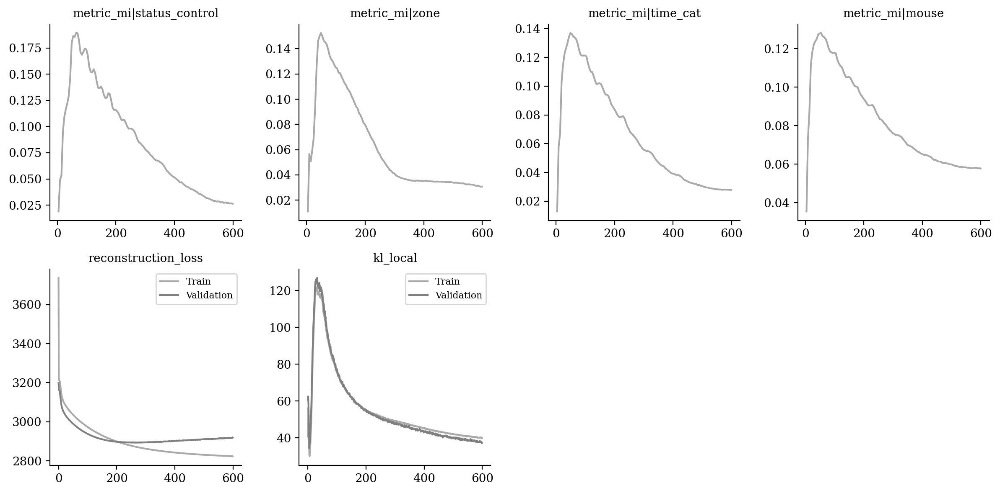

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

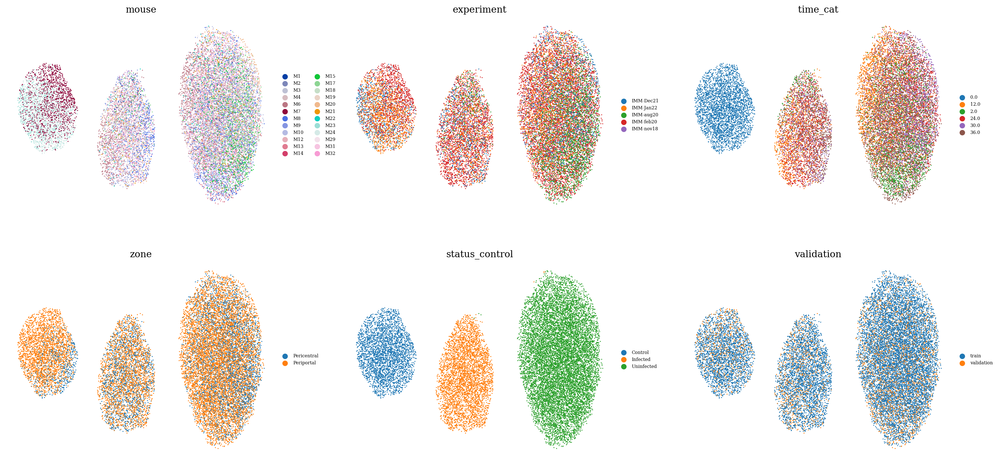

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

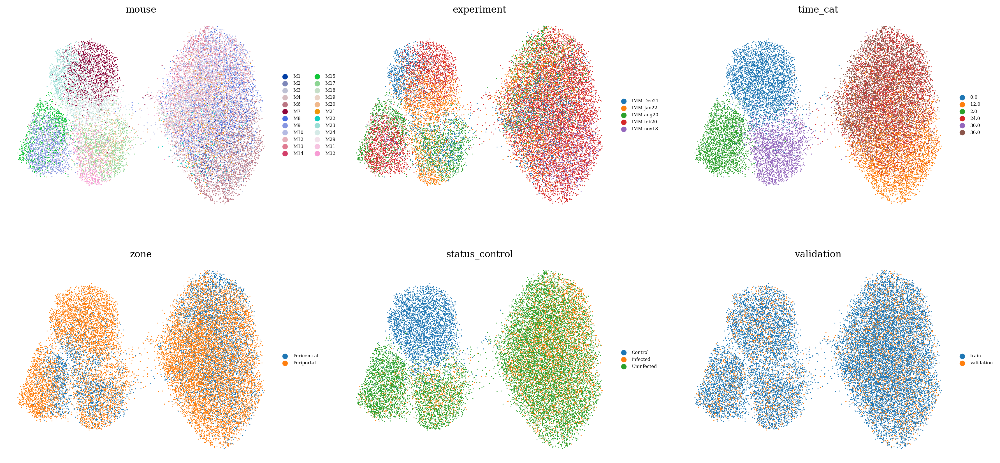

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

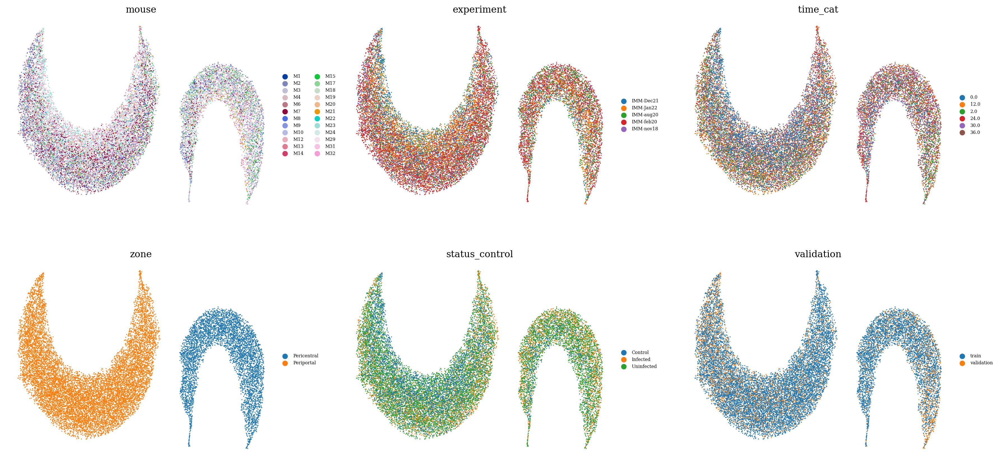

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

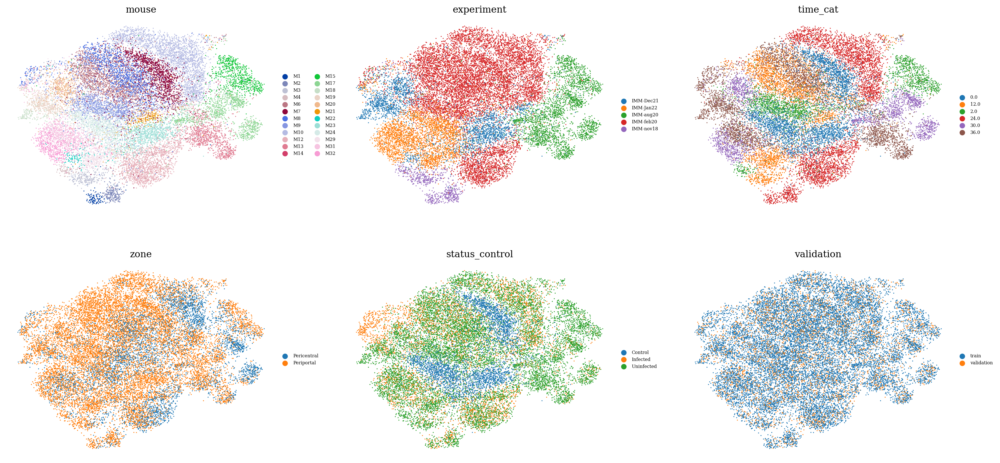

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

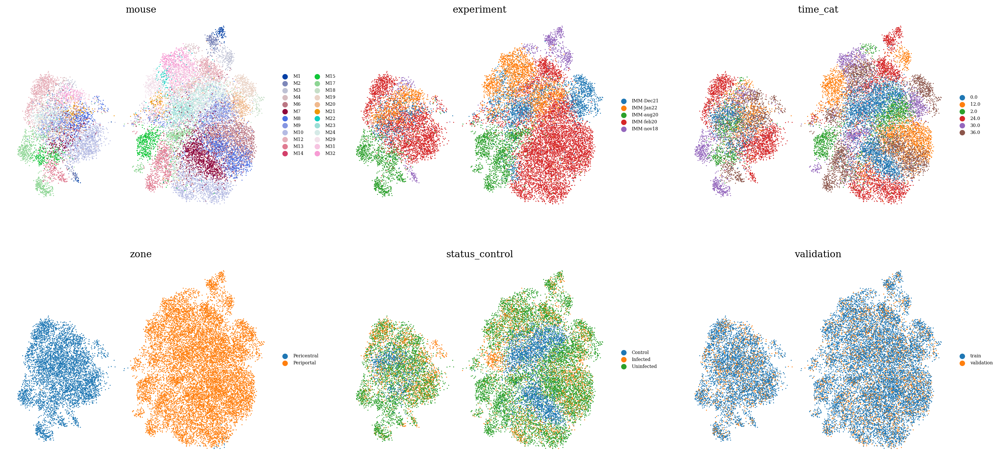

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

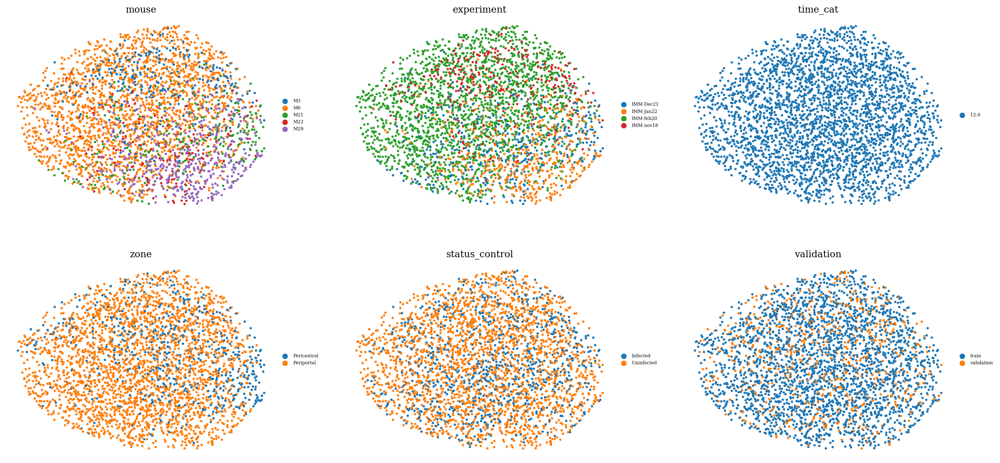

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )